# Correlaciones entre los datos

Este notebook contiene el código para generar los pairplots y los mapas de calor usados en la memoria del TFM.

## Datos

Importamos las librerías necesarias y el dataset:

In [1]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn 
print(seaborn.__version__)

0.13.0


In [2]:
# Permite ajustar la anchura de la parte útil de la libreta (reduce los márgenes)
from IPython.display import display, HTML
display(HTML("<style>.container{ width:98% }</style>"))

import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression
import re
import os

%config InlineBackend.figure_format = "retina"

In [3]:
df_data = pd.read_csv('data.csv')

# Definimos las funciones para hallar las correlaciones de Pearson y Spearman junto con su *p*-valor

In [4]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, spearmanr
import os
os.getcwd()
import corr_pvalue as corr

### Comparación total

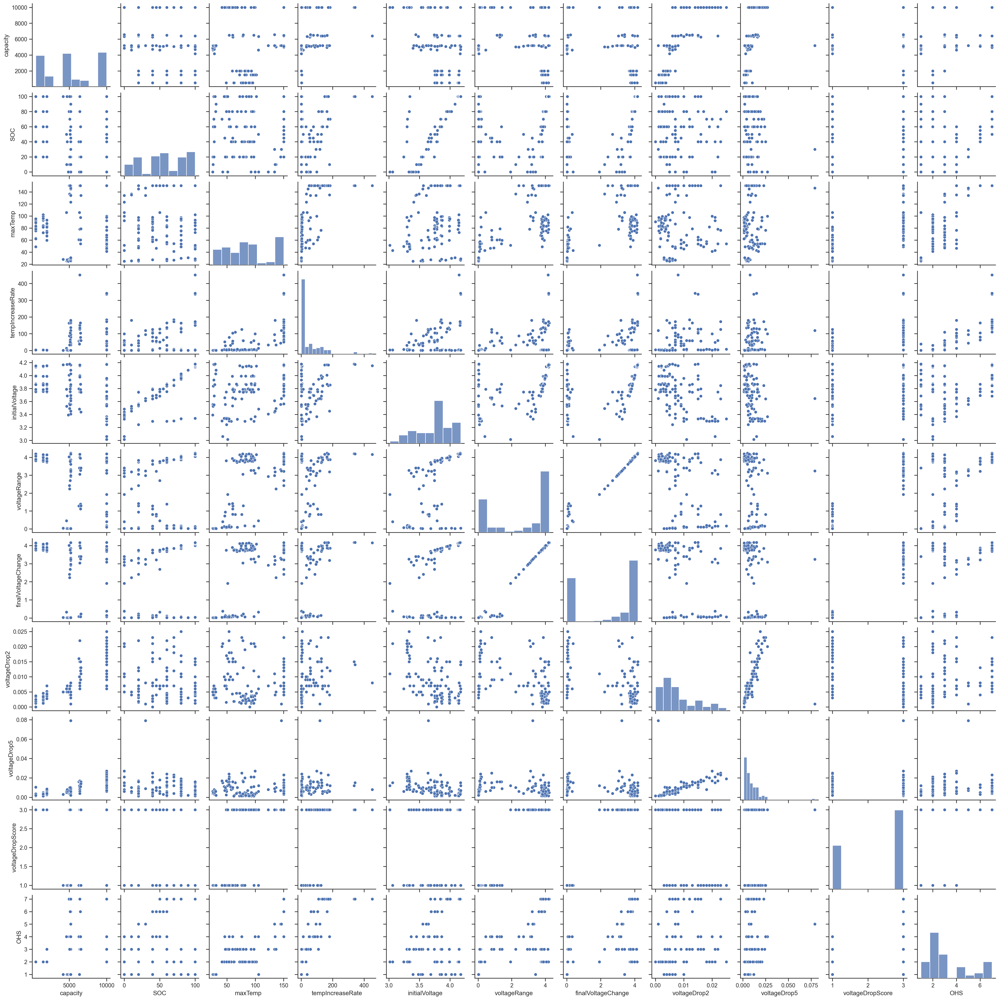

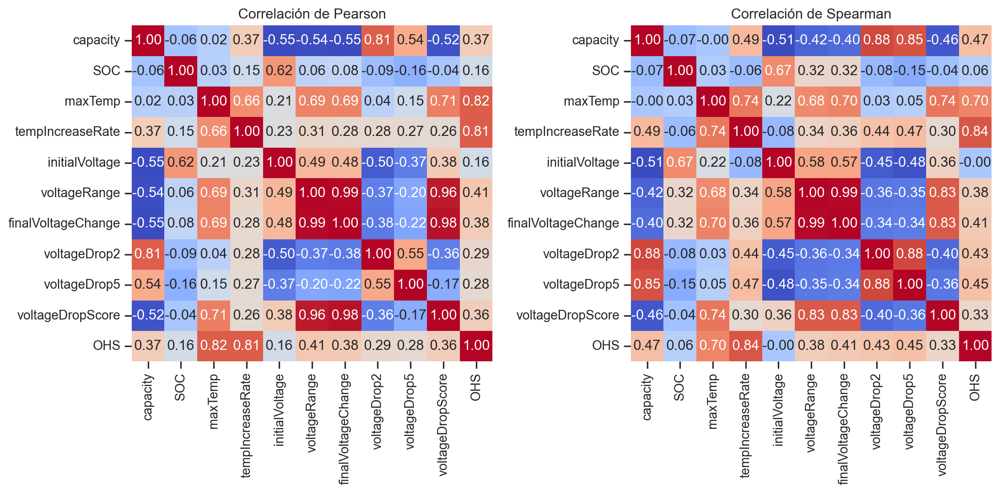

In [5]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, spearmanr

# Obtener las columnas numéricas
numeric_columns = df_data.columns[1:-2]

# Crear la matriz de gráficos de dispersión
sns.set(style="ticks")
sns.pairplot(df_data[numeric_columns])

# Calcular las correlaciones de Pearson y Spearman
corr_pearson = df_data[numeric_columns].corr(method='pearson')
corr_spearman = df_data[numeric_columns].corr(method='spearman')

# Mostrar las matrices de correlación
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.heatmap(corr_pearson, annot=True, cmap='coolwarm', fmt=".2f", cbar=False)
plt.title("Correlación de Pearson")

plt.subplot(1, 2, 2)
sns.heatmap(corr_spearman, annot=True, cmap='coolwarm', fmt=".2f", cbar=False)
plt.title("Correlación de Spearman")

plt.tight_layout()
plt.show()


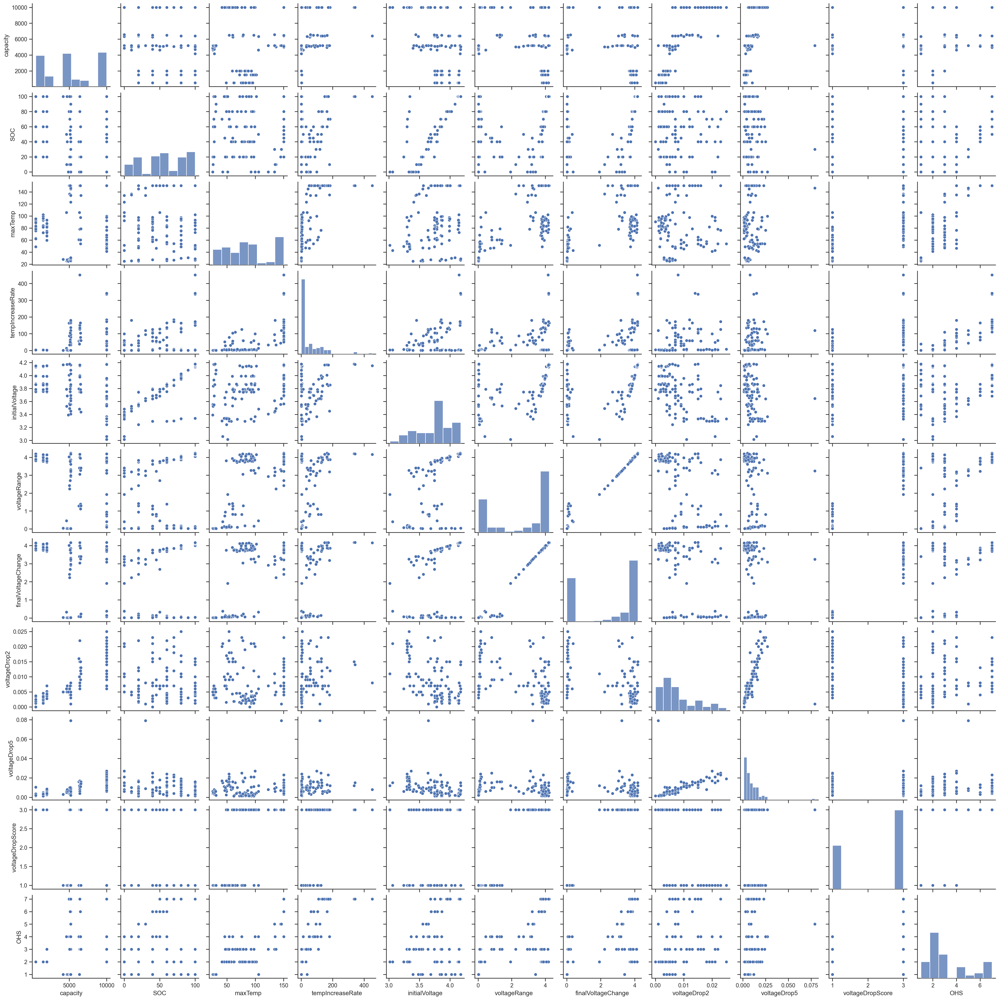

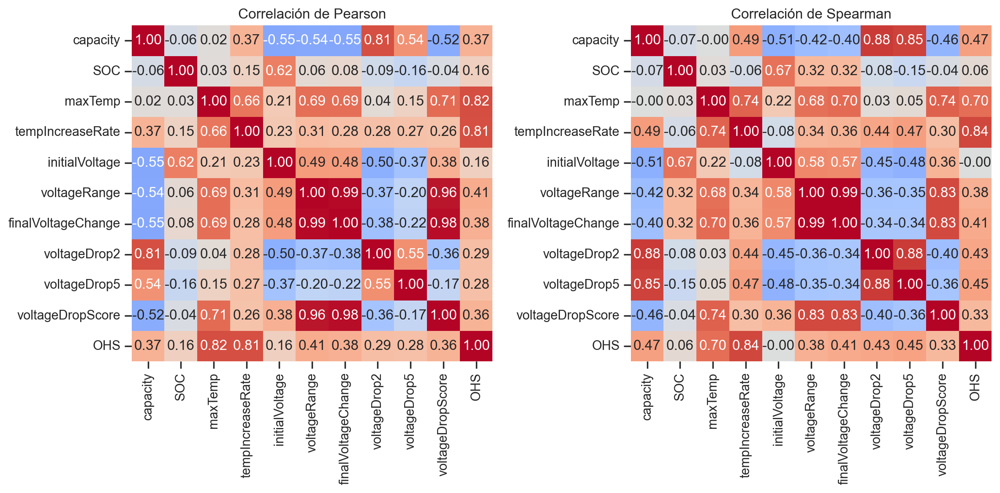

In [6]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, spearmanr

# Ajustar la configuración de pandas
# pd.set_option('mode.use_inf_as_na', False)

# Obtener las columnas numéricas
numeric_columns = df_data.columns[1:-2]

# Crear la matriz de gráficos de dispersión
sns.set(style="ticks")
sns.pairplot(df_data[numeric_columns])

# Calcular las correlaciones de Pearson y Spearman
corr_pearson = df_data[numeric_columns].corr(method='pearson')
corr_spearman = df_data[numeric_columns].corr(method='spearman')

# Mostrar las matrices de correlación
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.heatmap(corr_pearson, annot=True, cmap='coolwarm', fmt=".2f", cbar=False, vmin=-1, vmax=1)
plt.title("Correlación de Pearson")

plt.subplot(1, 2, 2)
sns.heatmap(corr_spearman, annot=True, cmap='coolwarm', fmt=".2f", cbar=False, vmin=-1, vmax=1)
plt.title("Correlación de Spearman")

plt.tight_layout()
plt.show()


# GUARDAMOS IMÁGENES DE CORRELACIÓN Y MATRIZ DE DISPERSIÓN POR QUÍMICA

In [7]:
df_data.columns[1:-2]

Index(['capacity', 'SOC', 'maxTemp', 'tempIncreaseRate', 'initialVoltage',
       'voltageRange', 'finalVoltageChange', 'voltageDrop2', 'voltageDrop5',
       'voltageDropScore', 'OHS'],
      dtype='object')

In [8]:
df_data.chemistry.unique()

array(['LCO', 'LFP', 'NMC'], dtype=object)

In [9]:
numeric_columns = df_data.columns[1:-4]
columns_with_categ = df_data.columns[1:-2]


# Carpeta base para guardar las gráficas
base_folder = "correlacion_por_quimica_3"

for i in np.unique(df_data.chemistry.values):
    # Crear una carpeta para la química de la batería si no existe
    quimica_folder = os.path.join(base_folder, i)
    os.makedirs(quimica_folder, exist_ok=True)

    # i='NMC'
    bat_quim = df_data[df_data.chemistry==i]
    
    # Calcular las correlaciones de Pearson y Spearman
    #
    # Calcular la correlación de Spearman y los p-valores asociados
    corr_pearson, p_values_pearson = corr.pearson_with_pvalues(bat_quim, numeric_columns)
    # Filtrar los valores de correlación por p-valor menor que 0.05
    significant_correlation_pearson = corr_pearson[(p_values_pearson < 0.05) & (abs(corr_pearson)>=0.8)]  
    #
    # Calcular la correlación de Spearman y los p-valores asociados
    corr_spearman, p_values_spearman = corr.spearman_with_pvalues(bat_quim, columns_with_categ)
    # Filtrar los valores de correlación por p-valor menor que 0.05
    significant_correlation_spearman = corr_spearman[(p_values_spearman < 0.05) & (abs(corr_spearman)>=0.8)]  
    
    # Crear las subfiguras y guardarlas en la carpeta correspondiente
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    sns.heatmap(significant_correlation_pearson, annot=True, cmap='coolwarm', fmt=".2f", cbar=False, vmin=-1, vmax=1, ax=axes[0])
    axes[0].set_title(f"Correlación de Pearson {i}, ({len(bat_quim)} obs)")
    sns.heatmap(significant_correlation_spearman, annot=True, cmap='coolwarm', fmt=".2f", cbar=False, vmin=-1, vmax=1, ax=axes[1])
    axes[1].set_title(f"Correlación de Spearman {i}, ({len(bat_quim)} obs)")
    plt.tight_layout()
    plt.savefig(os.path.join(quimica_folder, f"correlaciones_{i}.png"))

    # Crear el Pair Plot y guardarlo en la carpeta correspondiente
    pair_plot = sns.pairplot(df_data[df_data.chemistry==i][numeric_columns])
    pair_plot.fig.suptitle(f'Matriz de gráficos de dispersión {i}', y=1.02)
    plt.tight_layout()
    pair_plot.savefig(os.path.join(quimica_folder, f"pair_plot_{i}.png"))

    # Cerrar las figuras para liberar memoria
    plt.close("all")


C:\Users\beca1\Documents\GitHub\PR-01062_ESA_INNOVATION_TFM_CH\COPY----------TFM_CODIGO\corr_pvalue.py:22: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p_val = pearsonr(df[i], df[j])
C:\Users\beca1\Documents\GitHub\PR-01062_ESA_INNOVATION_TFM_CH\COPY----------TFM_CODIGO\corr_pvalue.py:43: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p_val = spearmanr(df[i], df[j])


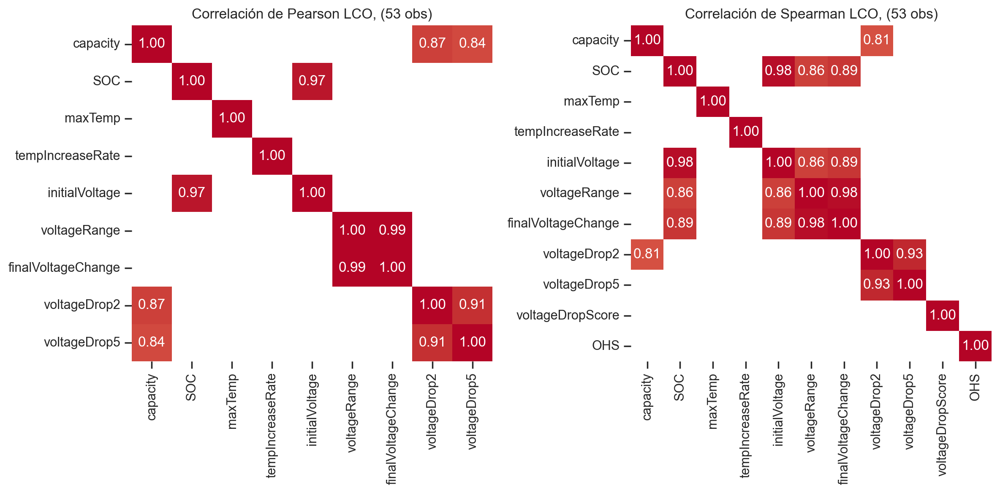

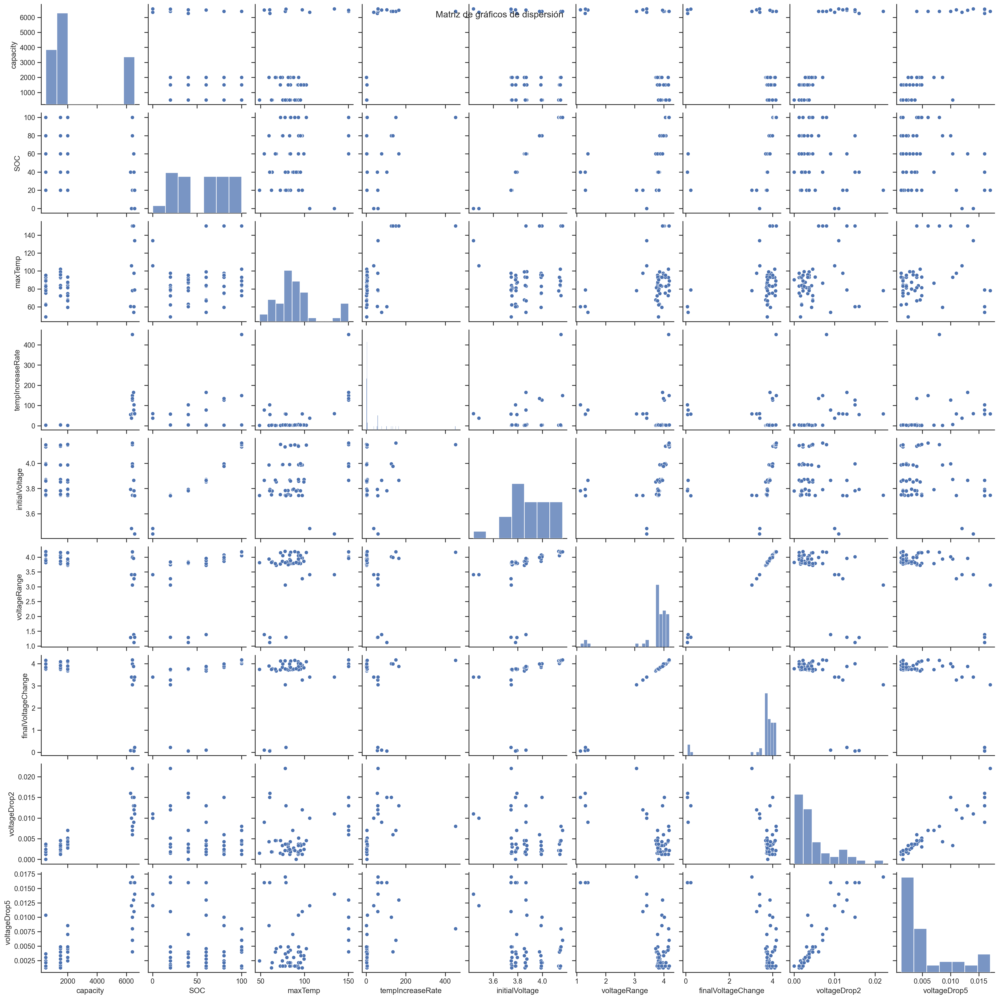

C:\Users\beca1\Documents\GitHub\PR-01062_ESA_INNOVATION_TFM_CH\COPY----------TFM_CODIGO\corr_pvalue.py:22: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p_val = pearsonr(df[i], df[j])
C:\Users\beca1\Documents\GitHub\PR-01062_ESA_INNOVATION_TFM_CH\COPY----------TFM_CODIGO\corr_pvalue.py:43: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  corr, p_val = spearmanr(df[i], df[j])


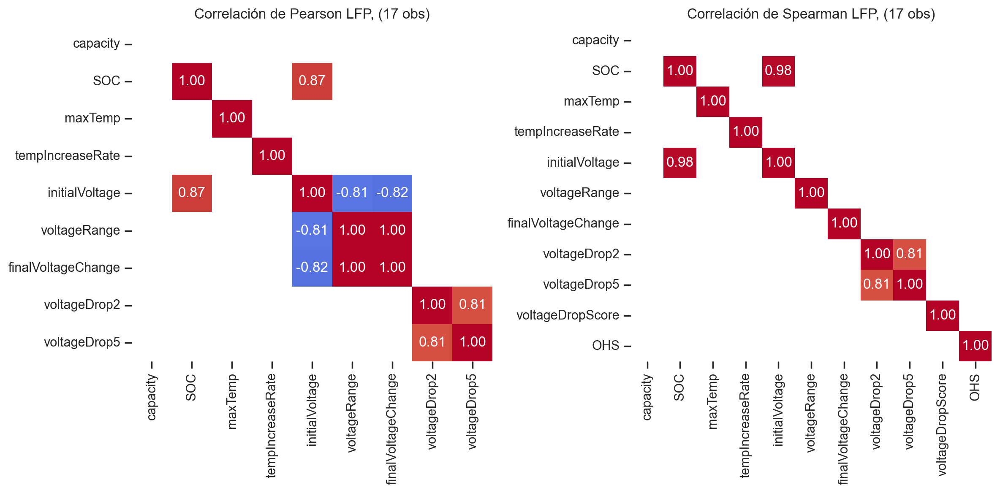

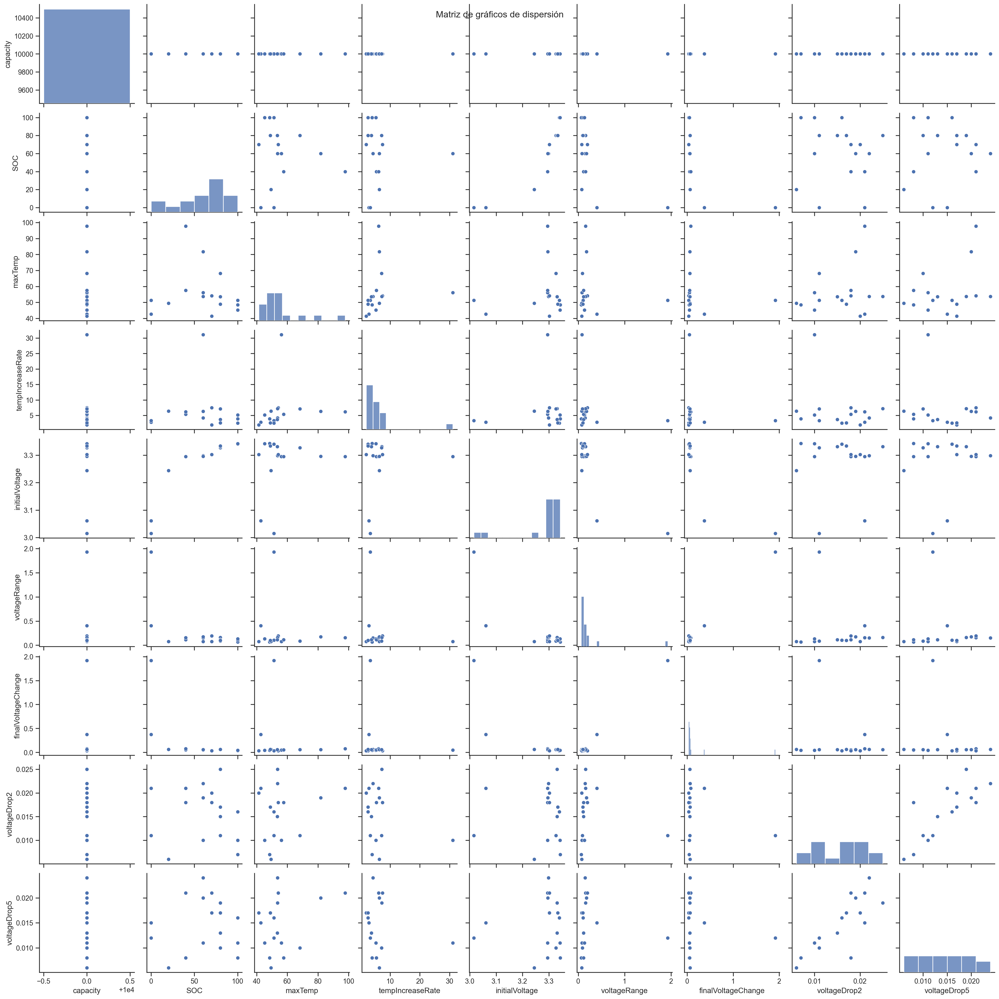

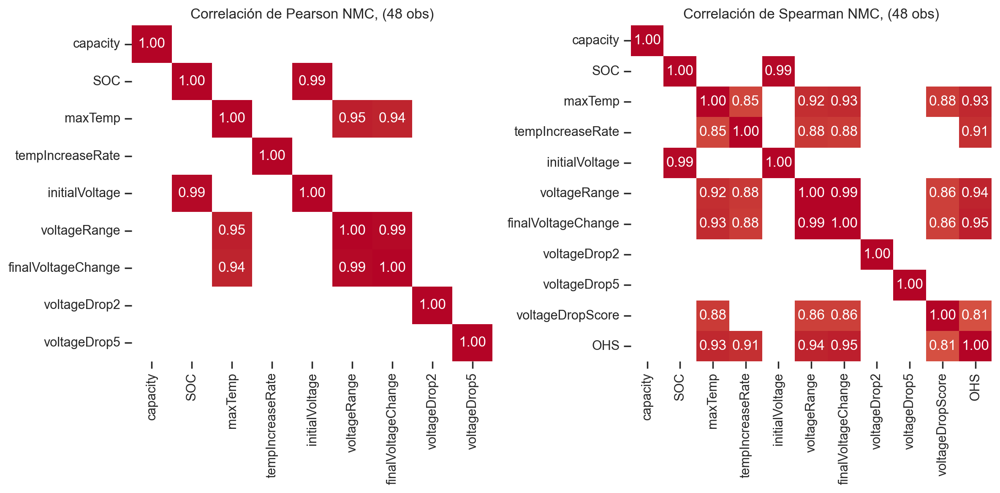

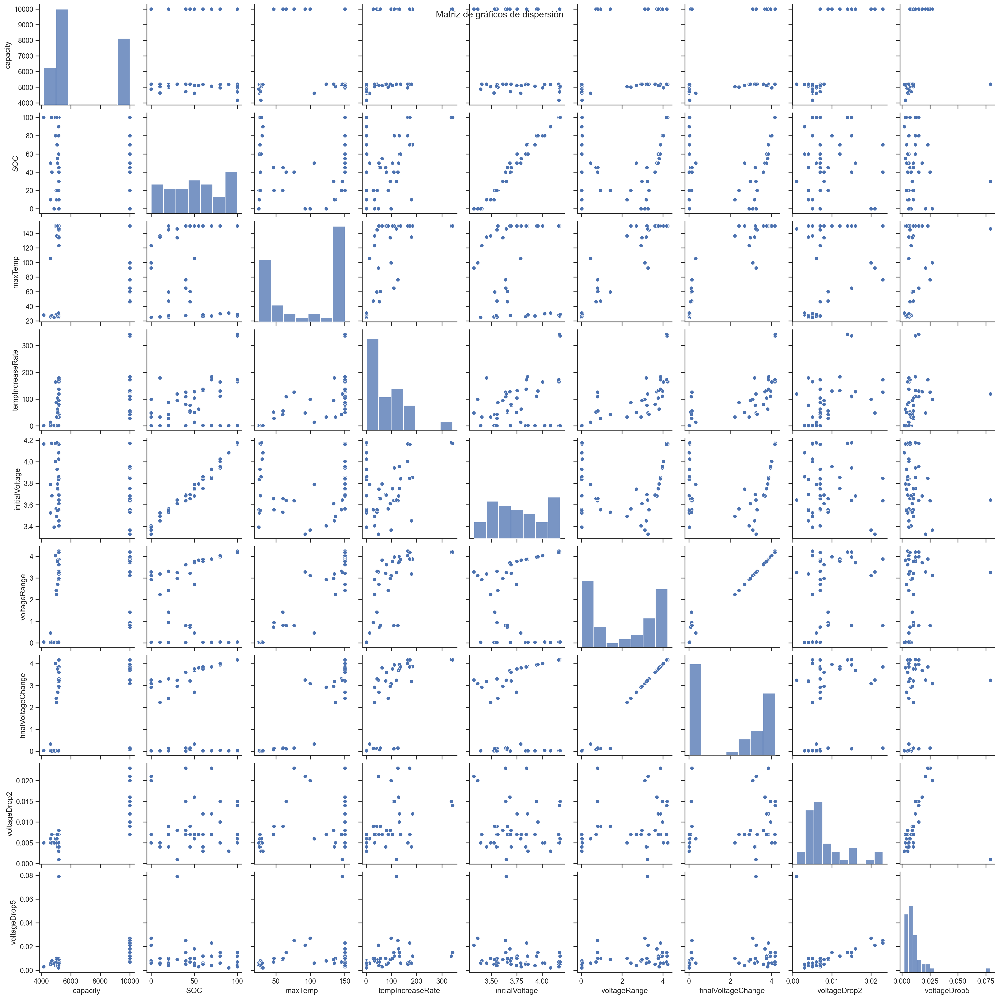

In [10]:
numeric_columns = df_data.columns[1:-4]
columns_with_categ = df_data.columns[1:-2]

quim_total = {}

for i in np.unique(df_data.chemistry.values):
    # i='NMC'
    bat_quim = df_data[df_data.chemistry==i]
    
    # display(bat_quim[numeric_columns])
    
    # Calcular las correlaciones de Pearson y Spearman
    #
    # Calcular la correlación de Spearman y los p-valores asociados
    corr_pearson, p_values_pearson = corr.pearson_with_pvalues(bat_quim, numeric_columns)
    # Filtrar los valores de correlación por p-valor menor que 0.05
    significant_correlation_pearson = corr_pearson[(p_values_pearson < 0.05) & (abs(corr_pearson)>=0.8)]  
    #
    # Calcular la correlación de Spearman y los p-valores asociados
    corr_spearman, p_values_spearman = corr.spearman_with_pvalues(bat_quim, columns_with_categ)
    # Filtrar los valores de correlación por p-valor menor que 0.05
    significant_correlation_spearman = corr_spearman[(p_values_spearman < 0.05) & (abs(corr_spearman)>=0.8)]  
    
    # display(corr_pearson, p_values_pearson, significant_correlation_pearson)
    # Mostrar las matrices de correlación
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    sns.heatmap(significant_correlation_pearson, annot=True, cmap='coolwarm', fmt=".2f", cbar=False, vmin=-1, vmax=1)
    plt.title(f"Correlación de Pearson {i}, ({len(bat_quim)} obs)")

    plt.subplot(1, 2, 2)
    sns.heatmap(significant_correlation_spearman, annot=True, cmap='coolwarm', fmt=".2f", cbar=False, vmin=-1, vmax=1)
    plt.title(f"Correlación de Spearman {i}, ({len(bat_quim)} obs)")

    plt.tight_layout()
    plt.show()
    
    # Crear una matriz de gráficos de dispersión
    sns.pairplot(df_data[df_data.chemistry==i][numeric_columns])
    plt.suptitle('Matriz de gráficos de dispersión')
    plt.show()


# Probar poner colores en el pair plot según el SOC 🔋

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Supongamos que tienes un DataFrame llamado "df" con tus datos
df = pd.read_csv('data.csv')
df = df.drop(columns='CHS')

# try with chemistries

Pintamos los pair plot según la química, para después reducirlo a las baterías que se concentran en el mismo rango de capacidad.

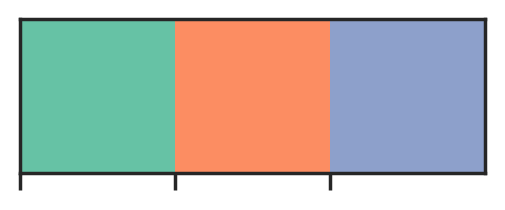

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt

# Lista de valores para los cuales deseas asignar colores
valores = sorted(df['chemistry'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("Set2", len(valores))

# Muestra la paleta de colores
sns.palplot(paleta_colores)
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


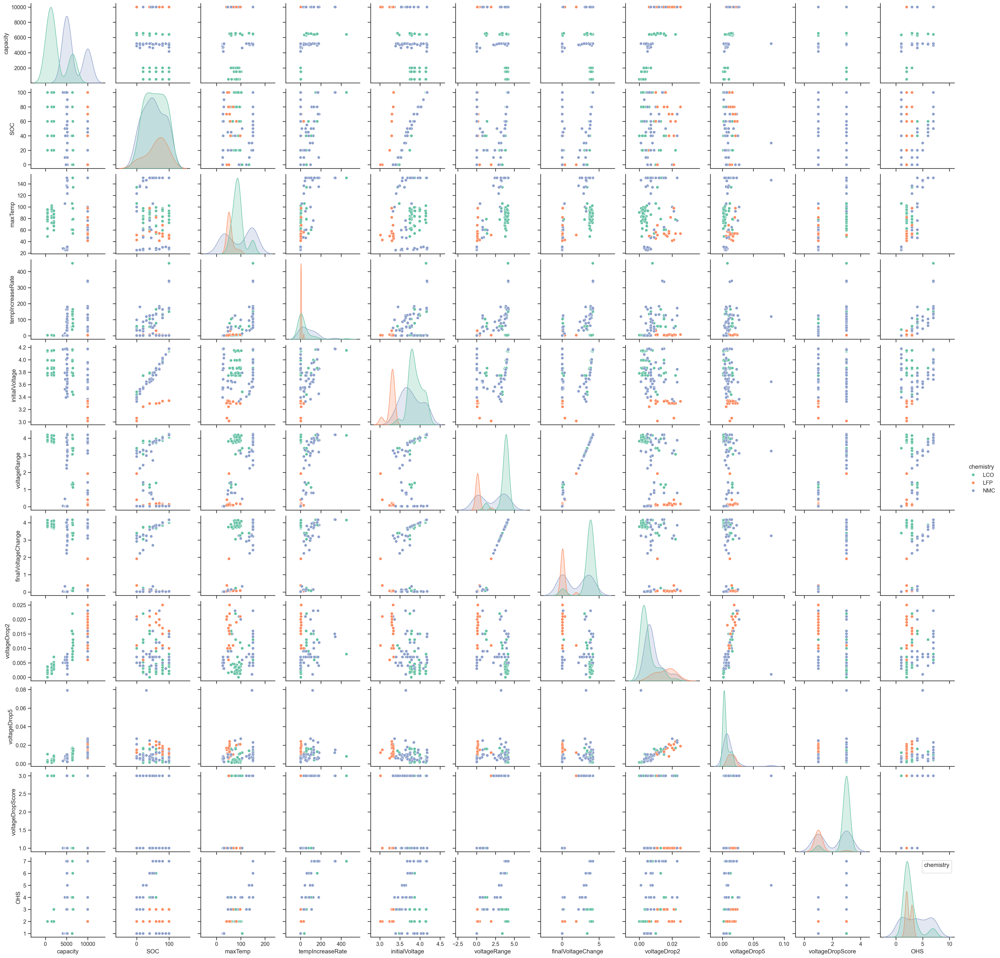

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt
import os

# Variable categórica para colorear los puntos
variable_color = "chemistry"

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df, hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_dataset_total_3"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_chem.png"))

chemistry
LFP    17
NMC    16
Name: count, dtype: int64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


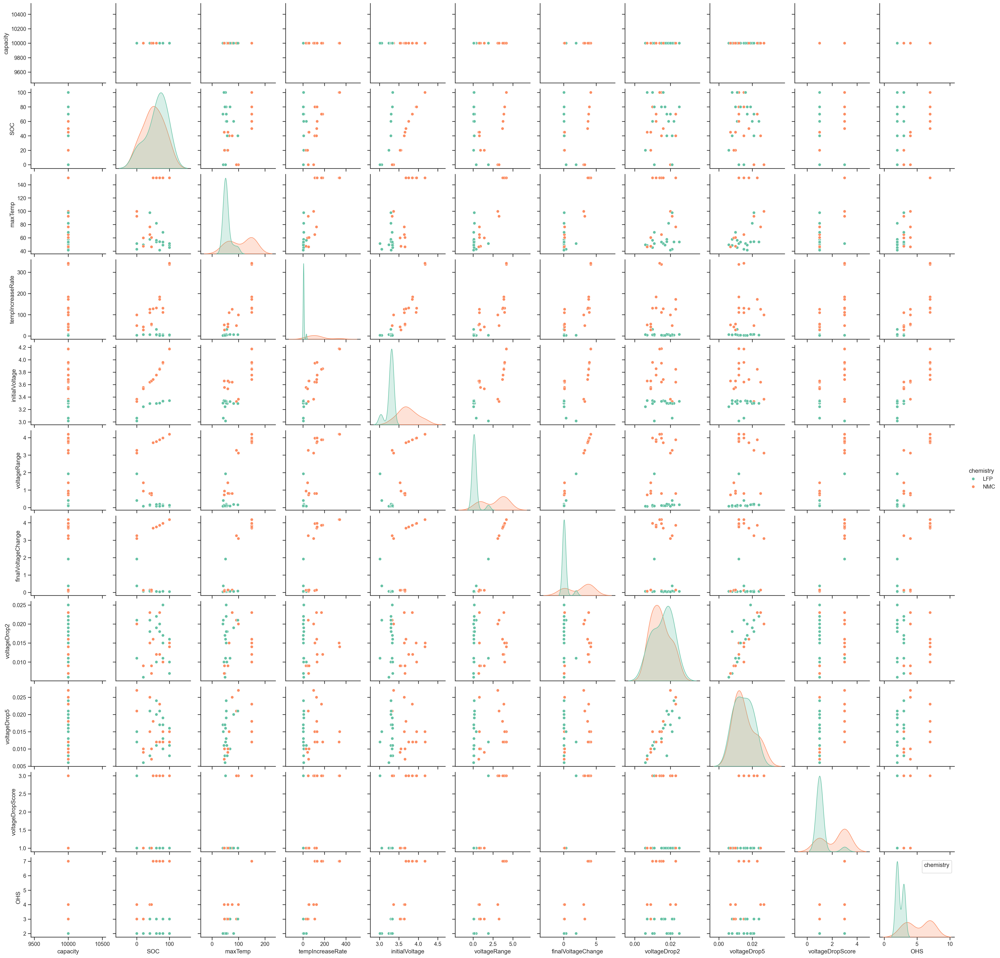

In [14]:
import seaborn as sns
import matplotlib.pyplot as plt
import os

df_ = df[10_000 == df.capacity]
print(df_.chemistry.value_counts())

# Variable categórica para colorear los puntos
variable_color = "chemistry"
# Define una paleta de colores usando una interpolación lineal entre colores
valores = sorted(df_['chemistry'].unique())
paleta_colores = sns.color_palette("Set2", len(valores))

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df_, hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_dataset_total_3"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_chem_10000mAh.png"))

chemistry
LFP    17
NMC    16
LCO     4
Name: count, dtype: int64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


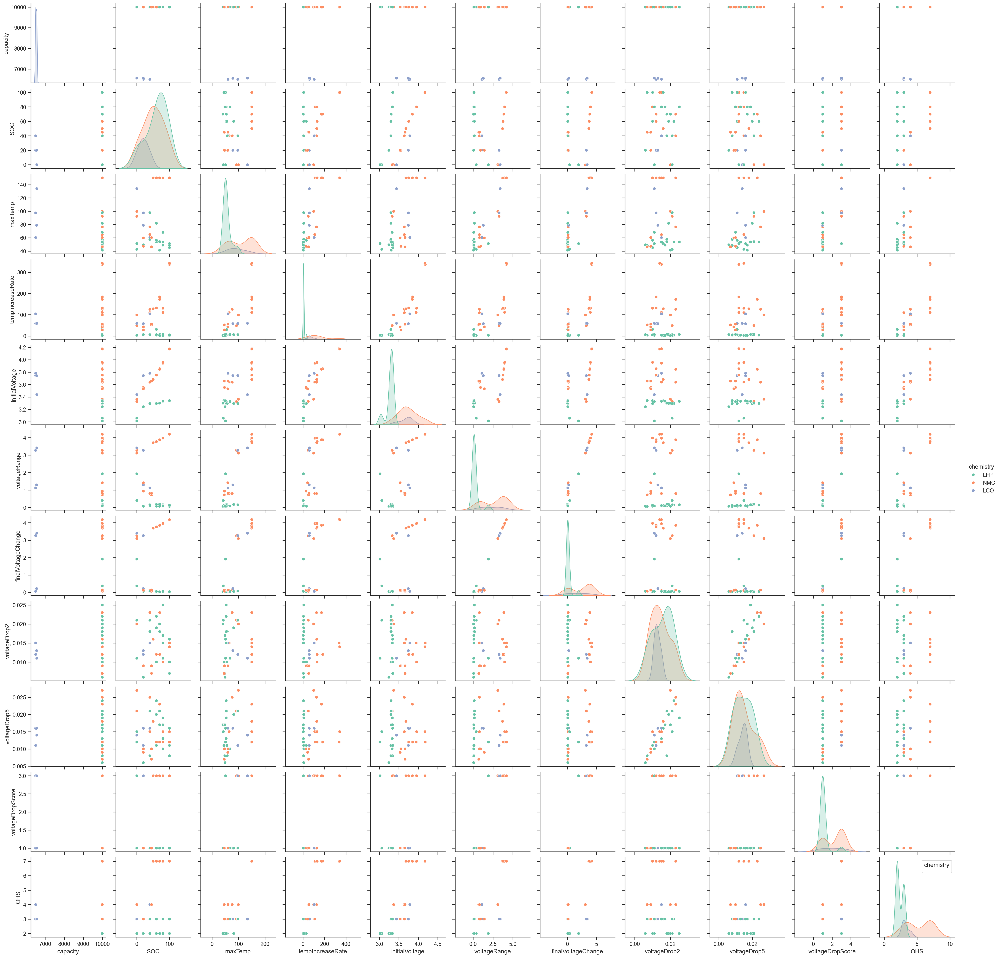

In [15]:
import seaborn as sns
import matplotlib.pyplot as plt
import os

df_ = df[6500 <= df.capacity]
print(df_.chemistry.value_counts())

# Variable categórica para colorear los puntos
variable_color = "chemistry"
# Define una paleta de colores usando una interpolación lineal entre colores
valores = sorted(df_['chemistry'].unique())
paleta_colores = sns.color_palette("Set2", len(valores))

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df_, hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_dataset_total_3"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_chem_6500.png"))

chemistry
LFP    17
NMC    16
LCO    13
Name: count, dtype: int64


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


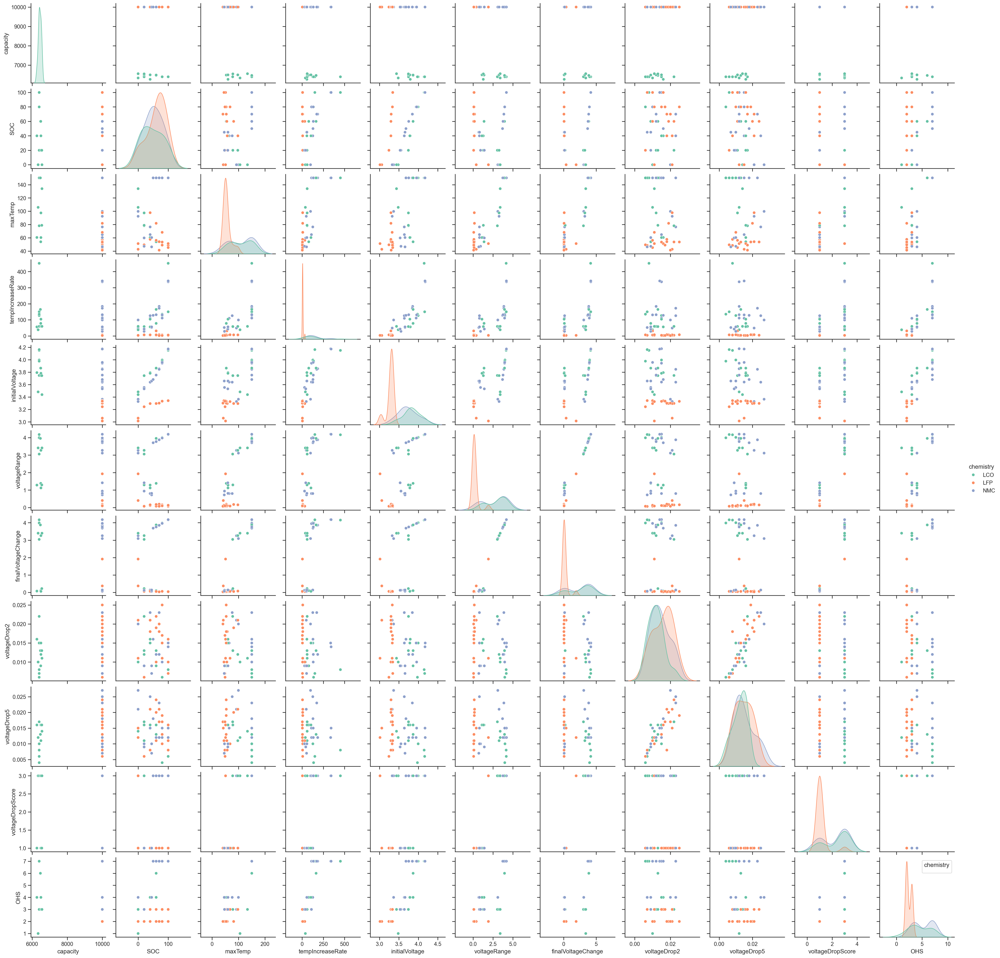

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt
import os

df_ = df[6000 <= df.capacity]
print(df_.chemistry.value_counts())

# Variable categórica para colorear los puntos
variable_color = "chemistry"
# Define una paleta de colores usando una interpolación lineal entre colores
valores = sorted(df_['chemistry'].unique())
paleta_colores = sns.color_palette("Set2", len(valores))

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df_, hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_dataset_total_3"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_chem_6000.png"))

Ahora pintamos según el SOC y generamos tantas gráficas como químicas:

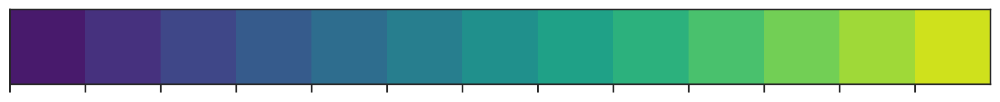

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt

# Lista de valores para los cuales deseas asignar colores
valores = sorted(df['SOC'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("viridis", len(valores))

# Muestra la paleta de colores
sns.palplot(paleta_colores)
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


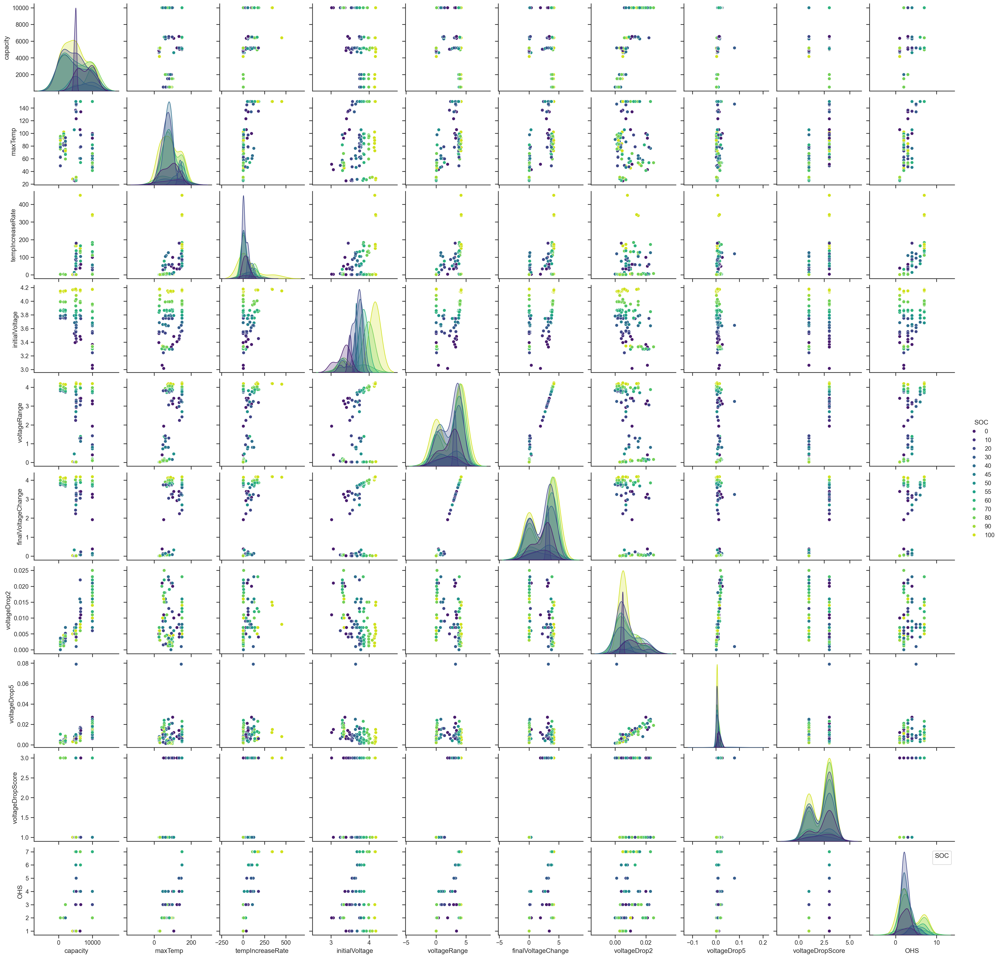

In [18]:
import seaborn as sns
import matplotlib.pyplot as plt
import os

# Lista de valores para los cuales deseas asignar colores
valores = sorted(df['SOC'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("viridis", len(valores))

# Variable categórica para colorear los puntos
variable_color = "SOC"

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df, hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_dataset_total_3"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_SOC.png"))

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


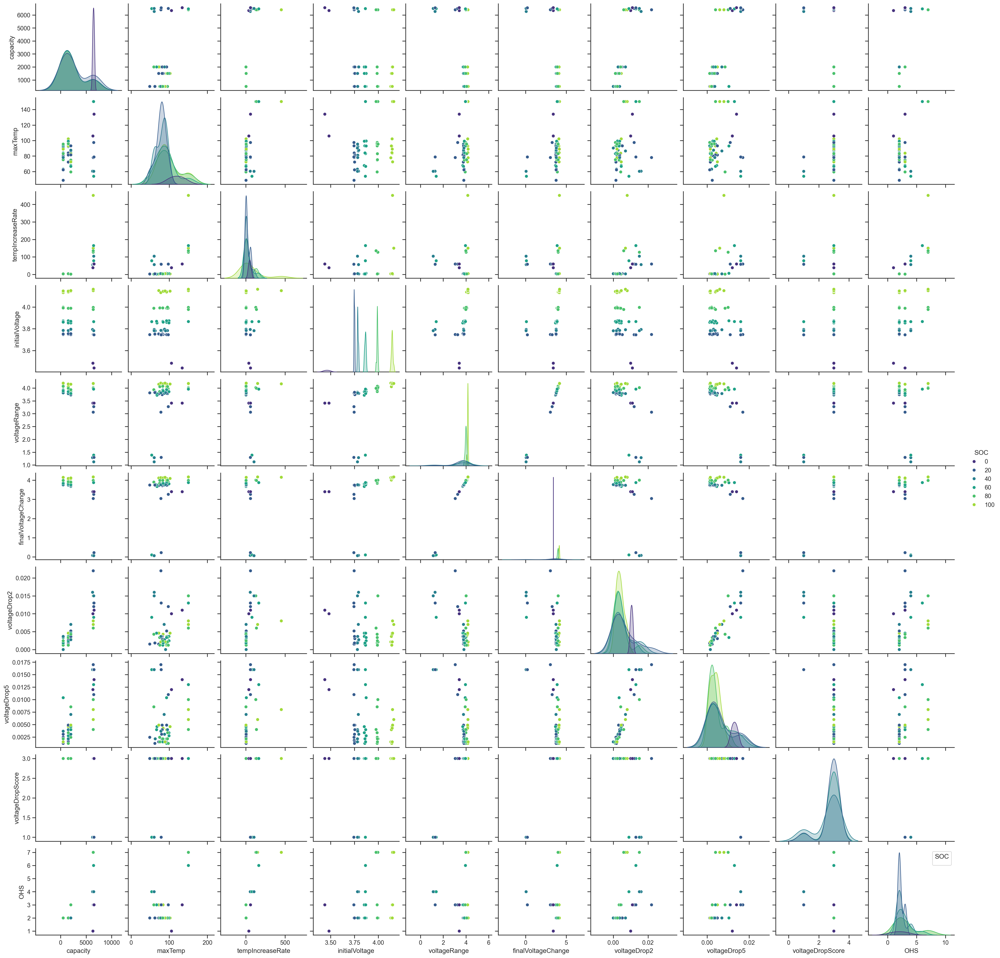

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt

# Lista de valores para los cuales deseas asignar colores
valores = sorted(df[df.chemistry=='LCO']['SOC'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("viridis", len(valores))

# Variable categórica para colorear los puntos
variable_color = "SOC"

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df[df.chemistry=='LCO'].iloc[:,:-1], hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_por_quimica_3/LCO"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_LCO_SOC.png"))

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


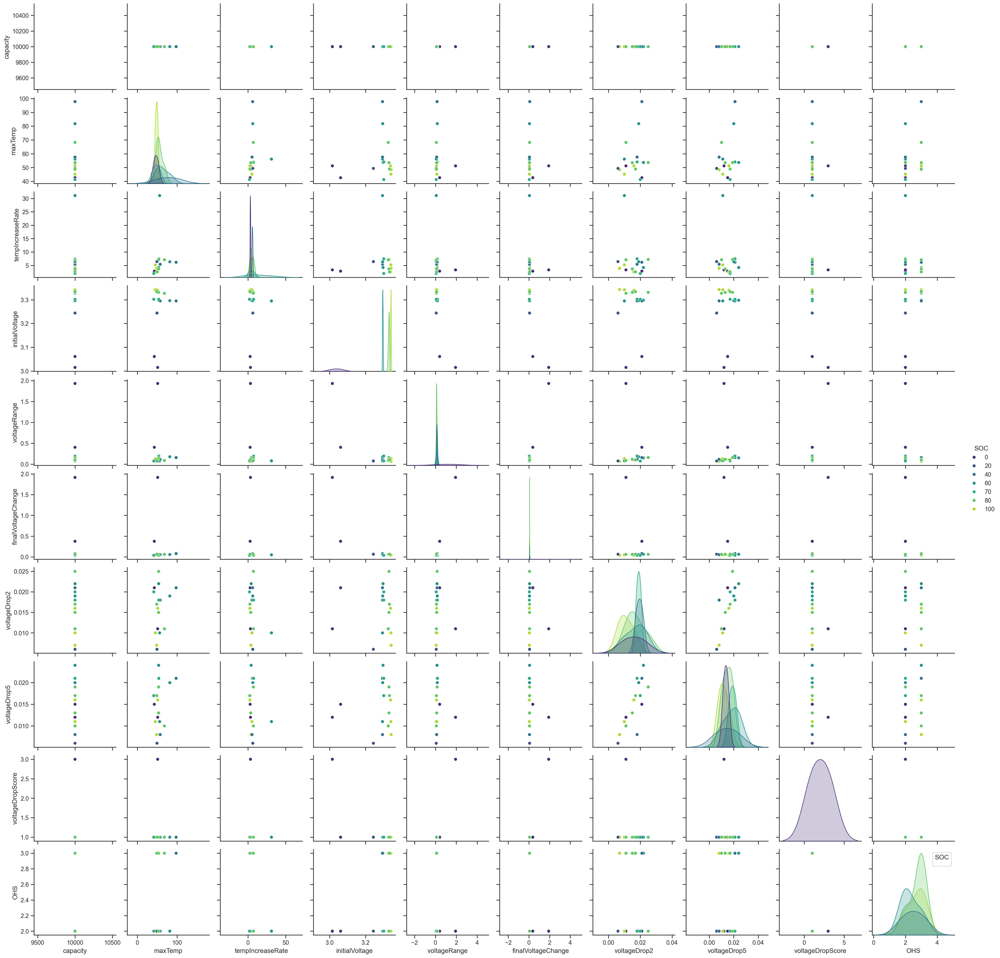

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt

# Lista de valores para los cuales deseas asignar colores
valores = sorted(df[df.chemistry=='LFP']['SOC'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("viridis", len(valores))

# Variable categórica para colorear los puntos
variable_color = "SOC"

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df[df.chemistry=='LFP'].iloc[:,:-1], hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_por_quimica_3/LFP"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_LFP_SOC.png"))

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


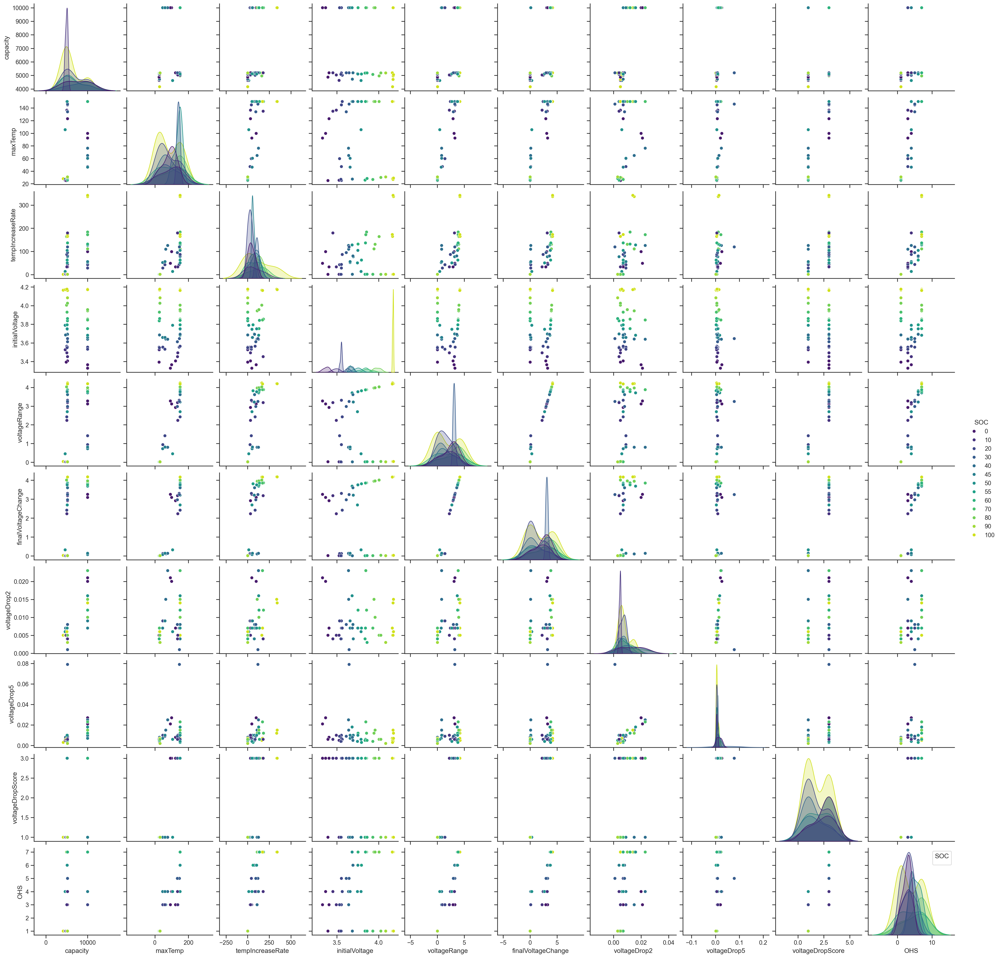

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

# Lista de valores para los cuales deseas asignar colores
valores = sorted(df[df.chemistry=='NMC']['SOC'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("viridis", len(valores))

# Variable categórica para colorear los puntos
variable_color = "SOC"

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df[df.chemistry=='NMC'].iloc[:,:-1], hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_por_quimica_3/NMC"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_NMC_SOC.png"))

Igual pero con la capacidad ⚡:

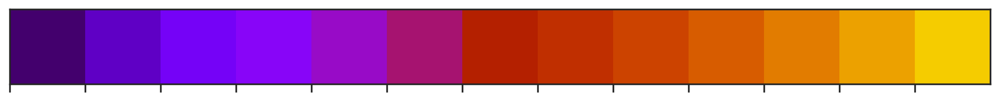

In [22]:
import seaborn as sns
import matplotlib.pyplot as plt

# Lista de valores para los cuales deseas asignar colores
valores = sorted(df['SOC'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("gnuplot", len(valores))

# Muestra la paleta de colores
sns.palplot(paleta_colores)
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


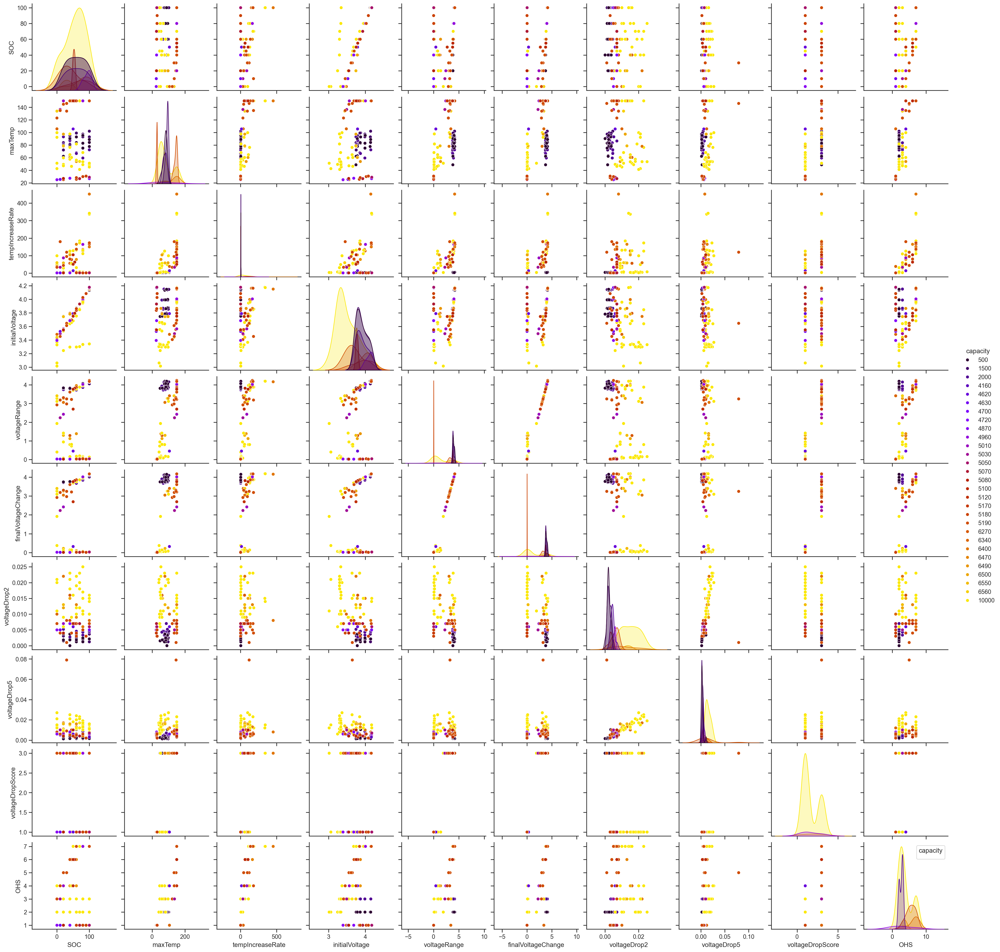

In [23]:
import seaborn as sns
import matplotlib.pyplot as plt
import os

# Lista de valores para los cuales deseas asignar colores
valores = sorted(df['capacity'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("gnuplot", len(valores))

# Variable categórica para colorear los puntos
variable_color = "capacity"

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df, hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_dataset_total3"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_cap.png"))

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


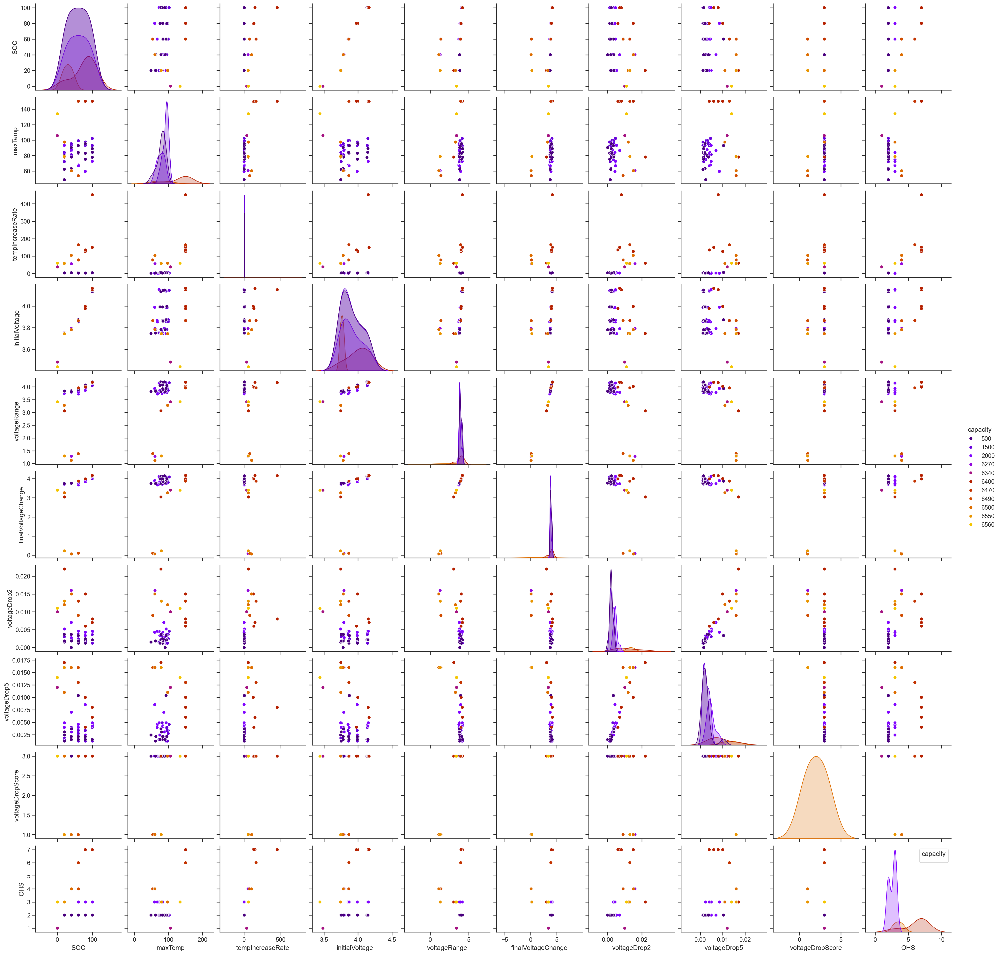

In [24]:
import seaborn as sns
import matplotlib.pyplot as plt
import os

# Lista de valores para los cuales deseas asignar colores
valores = sorted(df[df.chemistry=='LCO']['capacity'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("gnuplot", len(valores))

# Variable categórica para colorear los puntos
variable_color = "capacity"

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df[df.chemistry=='LCO'].iloc[:,:-1], hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_por_quimica_3/LCO"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_LCO_cap.png"))

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


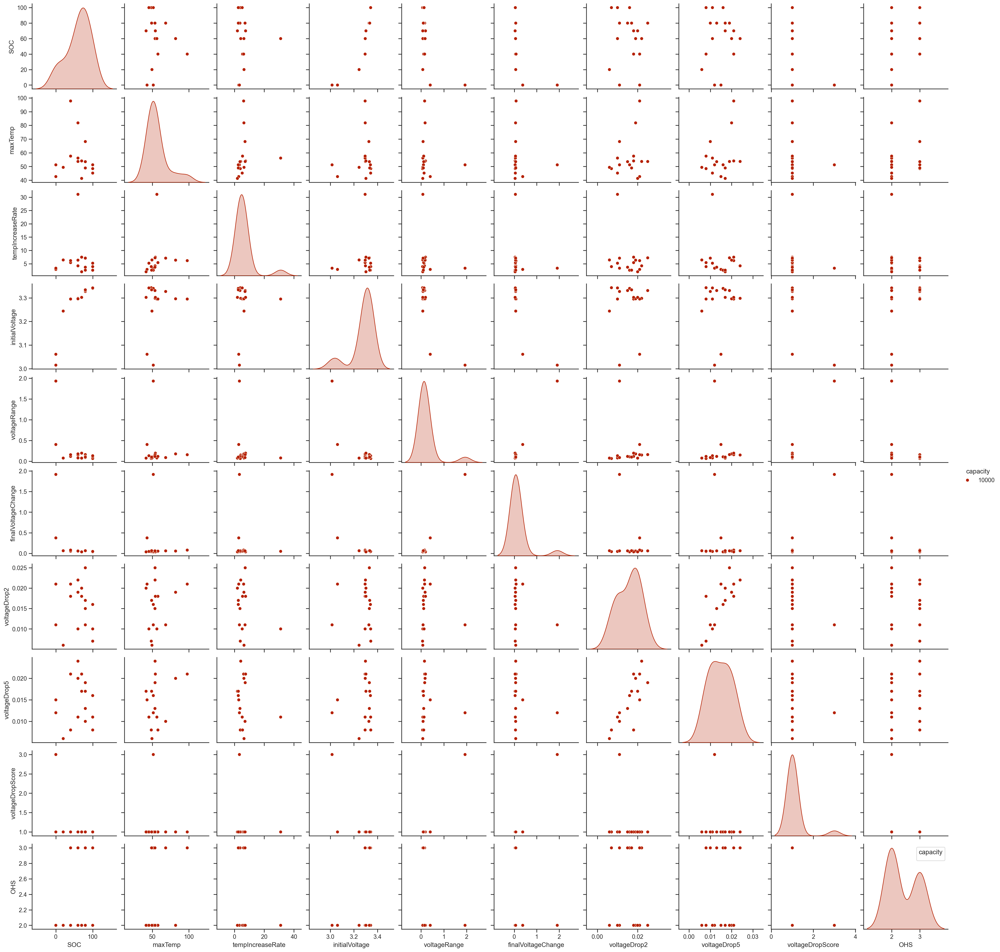

In [25]:
import seaborn as sns
import matplotlib.pyplot as plt

# Lista de valores para los cuales deseas asignar colores
valores = sorted(df[df.chemistry=='LFP']['capacity'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("gnuplot", len(valores))

# Variable categórica para colorear los puntos
variable_color = "capacity"

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df[df.chemistry=='LFP'].iloc[:,:-1], hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_por_quimica_3/LFP"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_LFP_cap.png"))

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


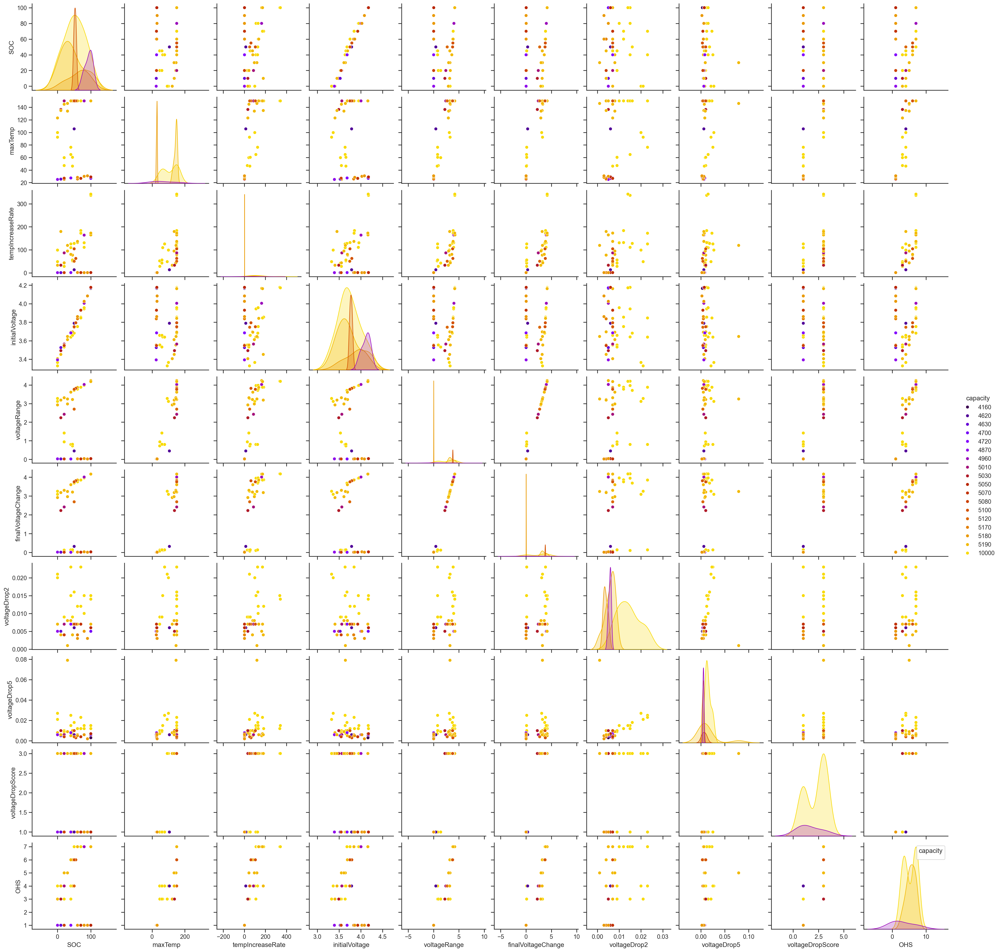

In [26]:
import seaborn as sns
import matplotlib.pyplot as plt


# Lista de valores para los cuales deseas asignar colores
valores = sorted(df[df.chemistry=='NMC']['capacity'].unique())

# Define una paleta de colores usando una interpolación lineal entre colores
paleta_colores = sns.color_palette("gnuplot", len(valores))

# Variable categórica para colorear los puntos
variable_color = "capacity"

# Crea el pair plot con Seaborn
pairplot = sns.pairplot(df[df.chemistry=='NMC'].iloc[:,:-1], hue=variable_color, palette=paleta_colores)

# Ajusta la leyenda para mostrar los nombres de las categorías
plt.legend(title=variable_color)

# Muestra el gráfico
plt.show()

# Guarda el gráfico como un archivo PNG en una carpeta específica
carpeta = "correlacion_por_quimica_3/NMC"
if not os.path.exists(carpeta):
    os.makedirs(carpeta)
pairplot.savefig(os.path.join(carpeta, "pairplot_NMC_cap.png"))

Tras observar las relaciones lineales en los pairplots, vamos a asegurar que no hjay puntos solapados que no se aprecian:

# FORMATO PARA IMÁGENES

Aquí se han generado figuras pero se tiene una función creada en `chap3-figs.ipybn` para visualizar mejor.

In [27]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Supongamos que tienes un DataFrame llamado "df" con tus datos
df = pd.read_csv('data.csv')
df_data = df.drop(columns='CHS')

### LCO

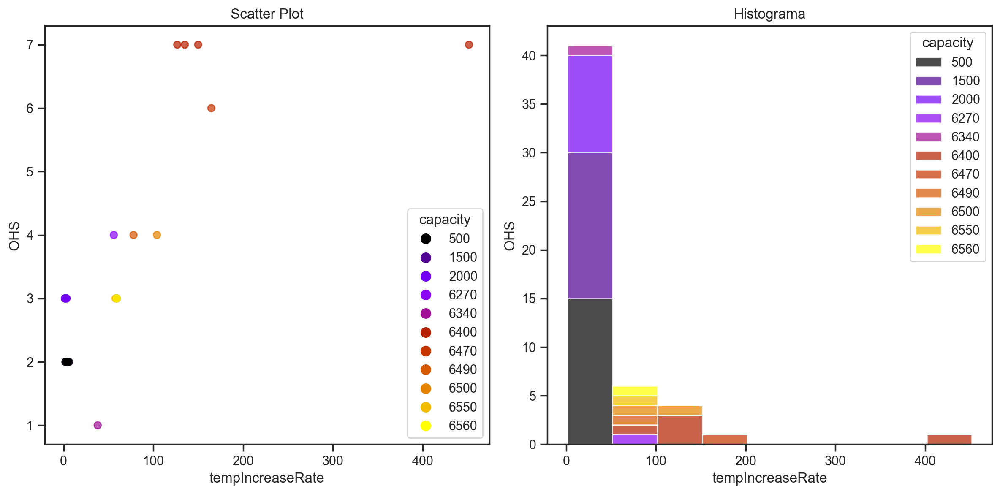

In [28]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].tempIncreaseRate
y = df_data[(df_data.chemistry==quim)].OHS
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


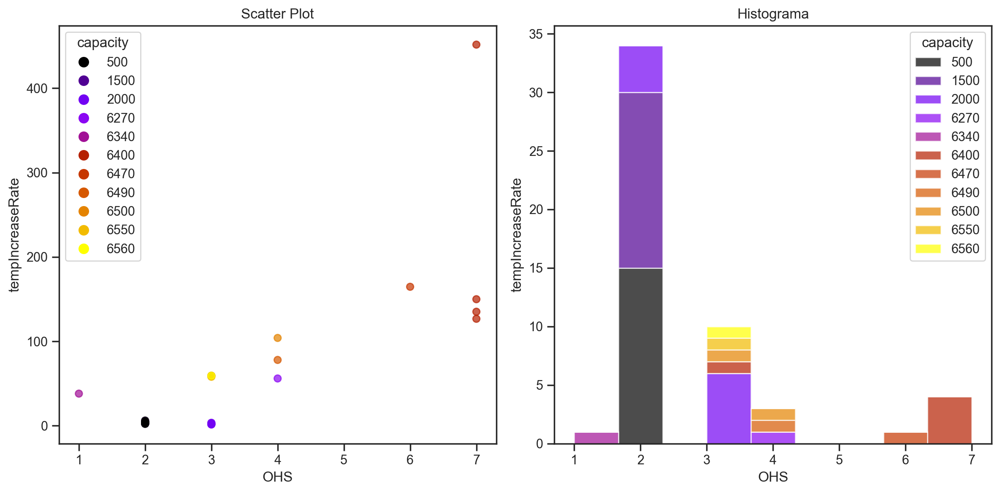

In [29]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].OHS
y = df_data[(df_data.chemistry==quim)].tempIncreaseRate
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


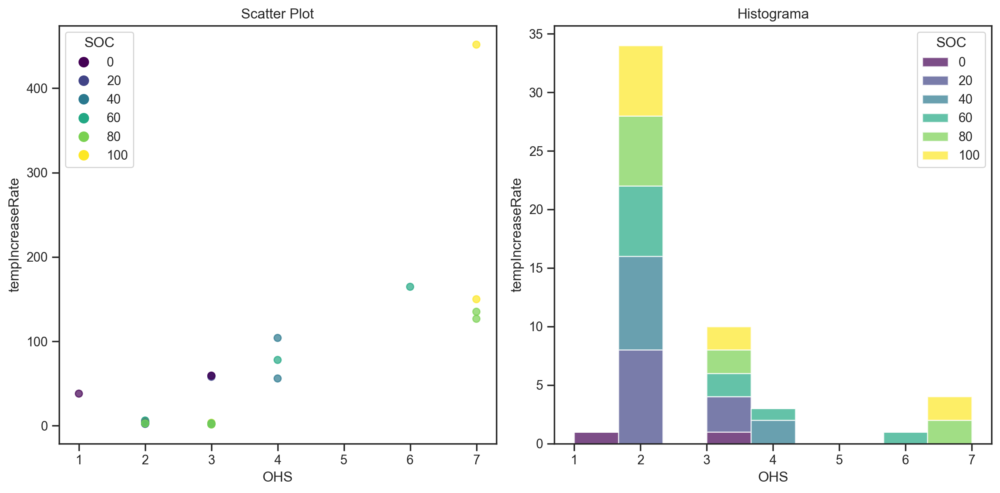

In [30]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].OHS
y = df_data[(df_data.chemistry==quim)].tempIncreaseRate
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


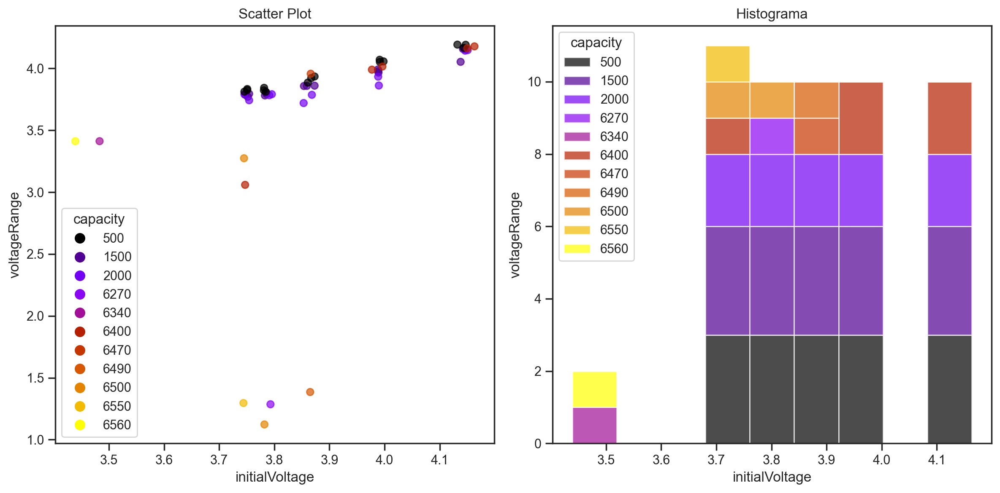

In [31]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].initialVoltage
y = df_data[(df_data.chemistry==quim)].voltageRange
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


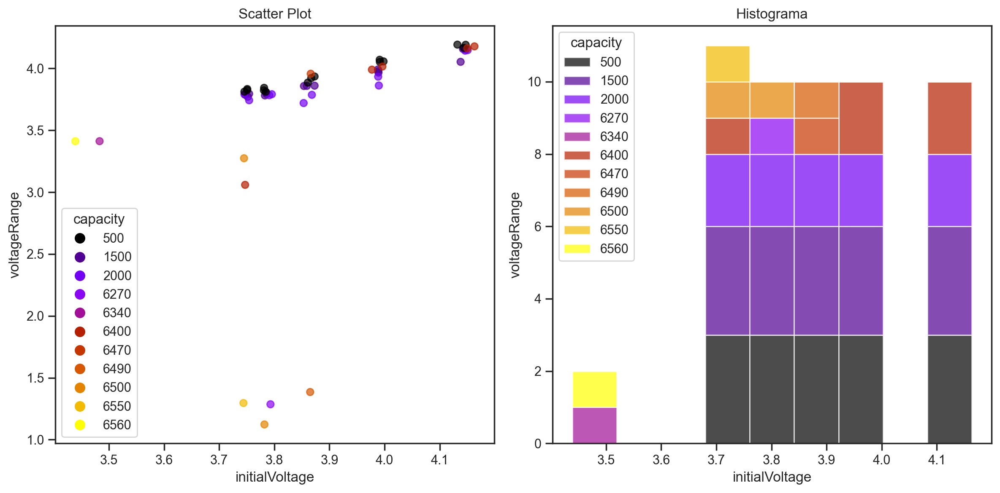

In [32]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].initialVoltage
y = df_data[(df_data.chemistry==quim)].voltageRange
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


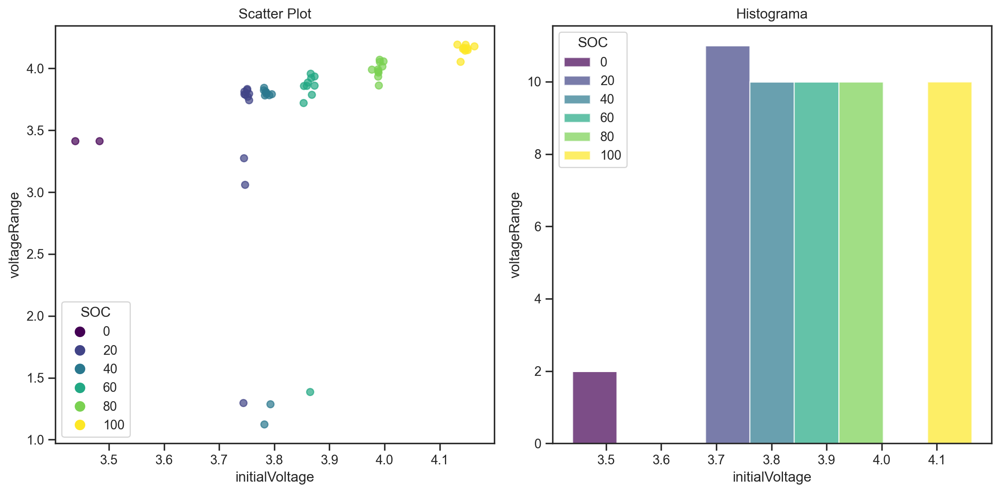

In [33]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].initialVoltage
y = df_data[(df_data.chemistry==quim)].voltageRange
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


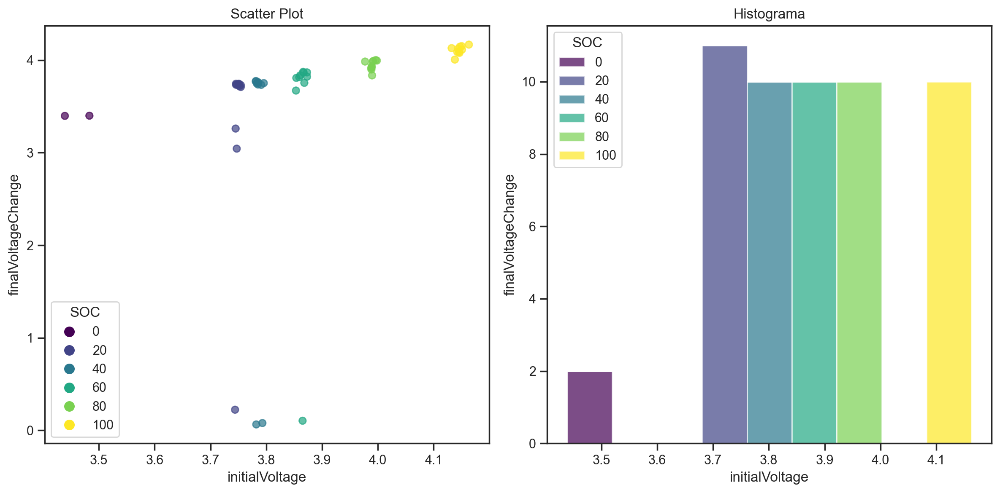

In [34]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].initialVoltage
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


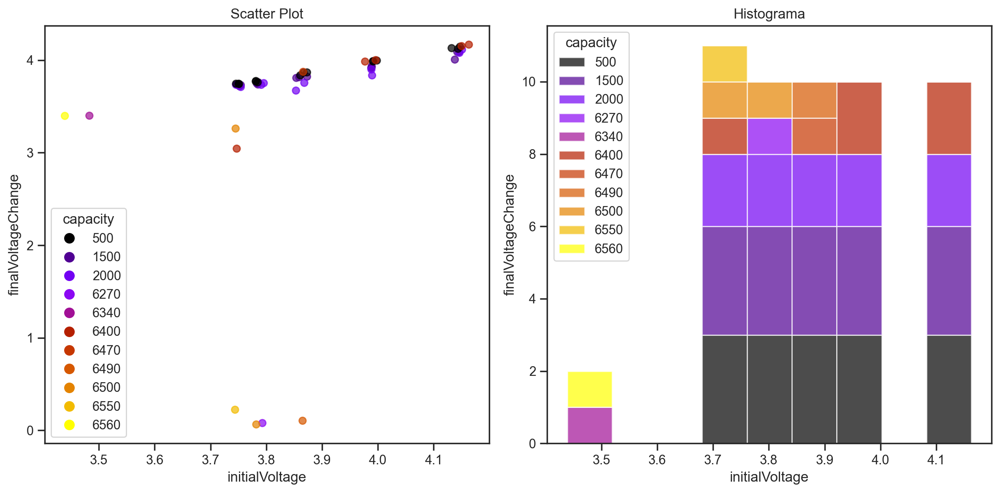

In [35]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].initialVoltage
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


#### FINALVOLT + VOLTRANG

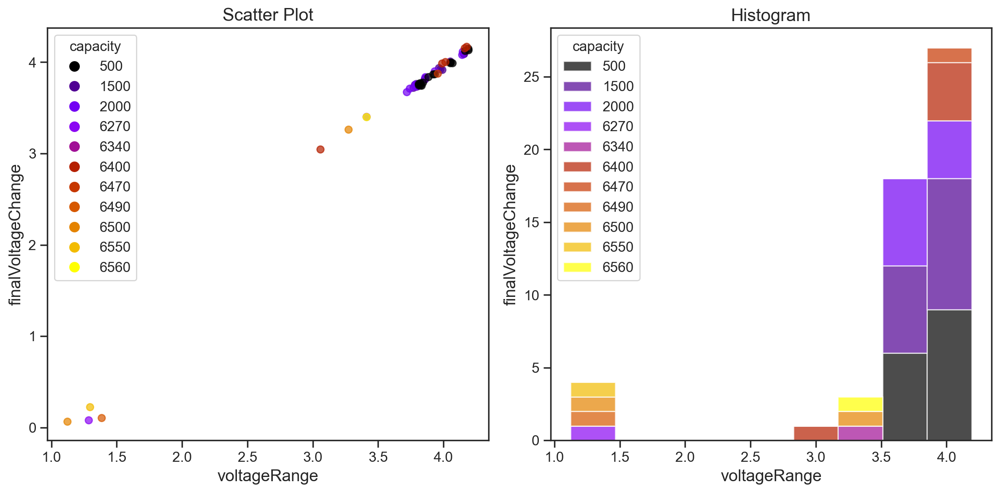

In [36]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}', fontsize=12,title_fontsize=12)
plt.title('Scatter Plot', fontsize=15)
plt.xlabel(f'{x.name}', fontsize=14)
plt.ylabel(f'{y.name}', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histogram', fontsize=15)
plt.xlabel(f'{x.name}', fontsize=14)
plt.ylabel(f'{y.name}', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title=f'{col.name}', fontsize=12, title_fontsize=12)

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


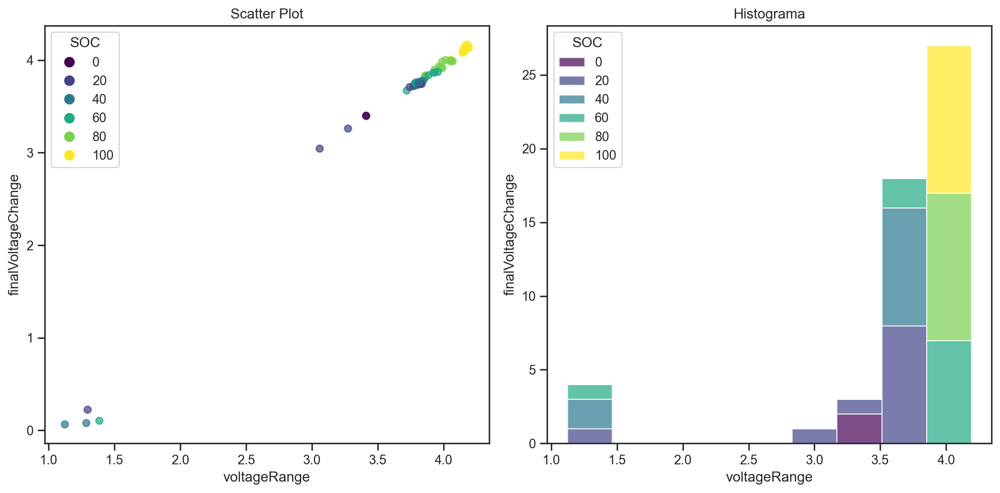

In [37]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


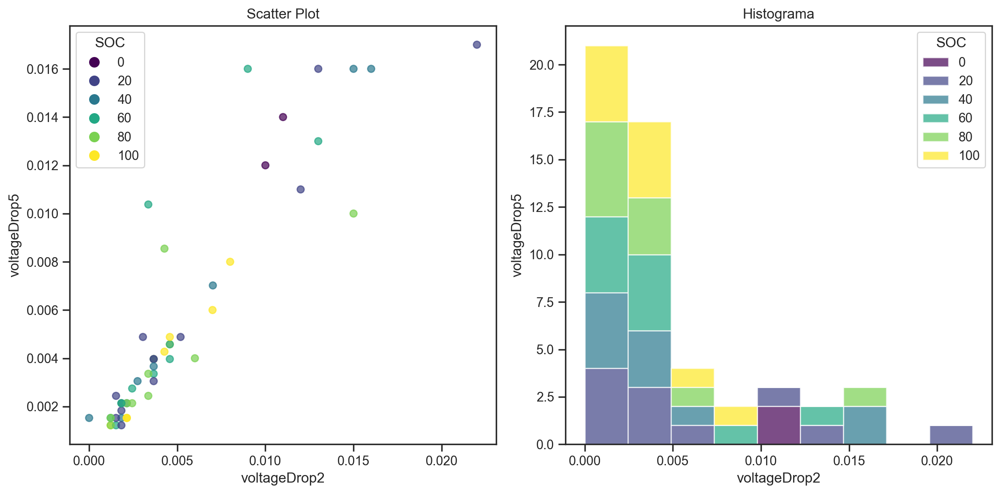

In [38]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].voltageDrop2
y = df_data[(df_data.chemistry==quim)].voltageDrop5
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


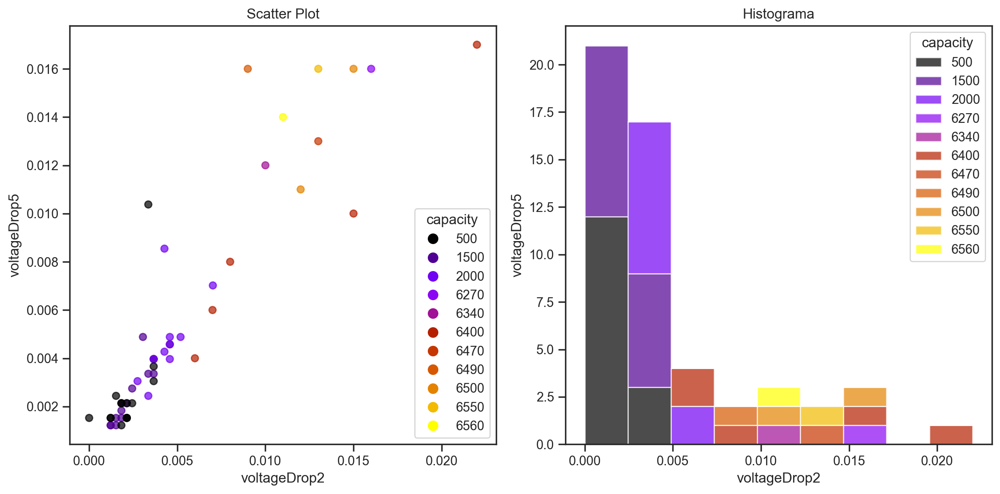

In [39]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].voltageDrop2
y = df_data[(df_data.chemistry==quim)].voltageDrop5
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


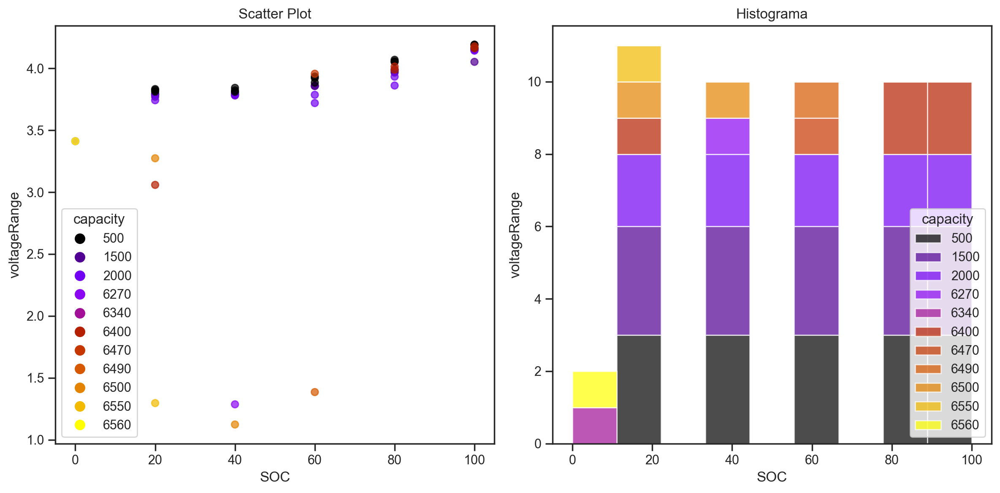

In [40]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LCO'
x = df_data[(df_data.chemistry==quim)].SOC
y = df_data[(df_data.chemistry==quim)].voltageRange
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


### LFP

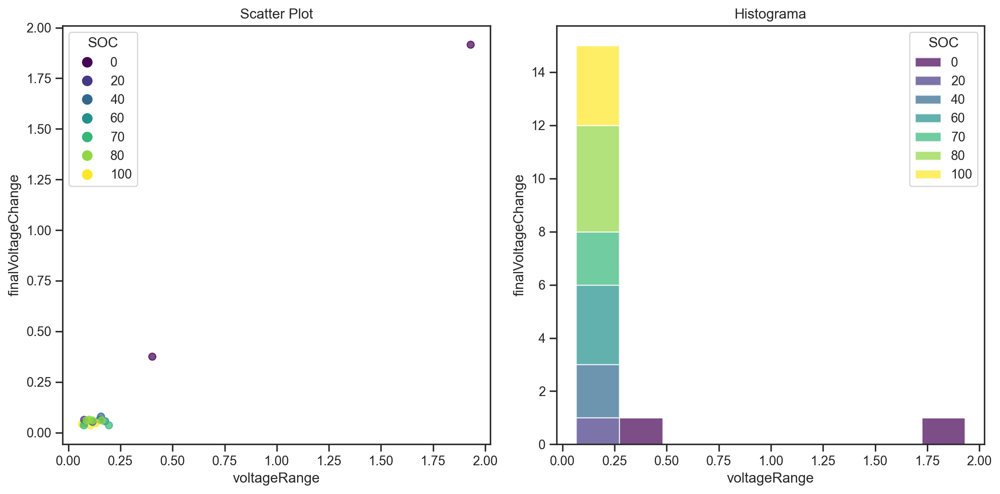

In [41]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LFP'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


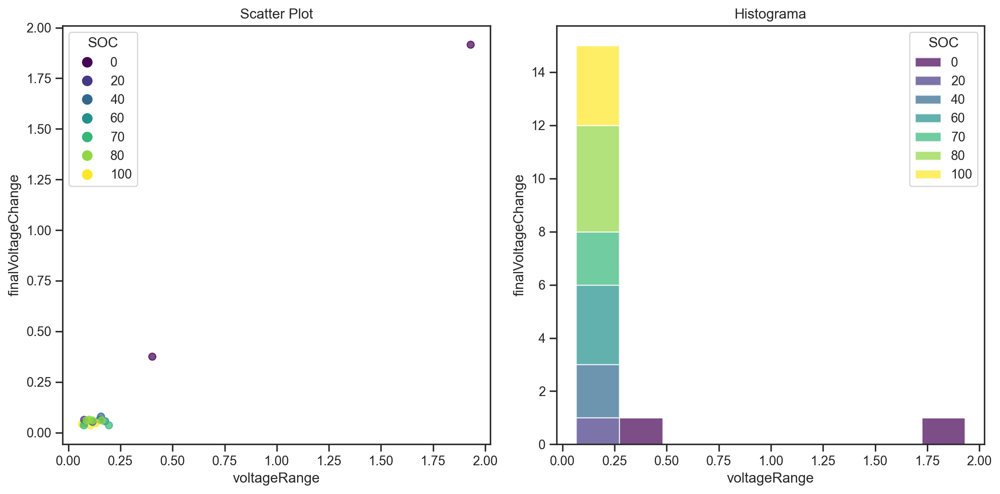

In [42]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LFP'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


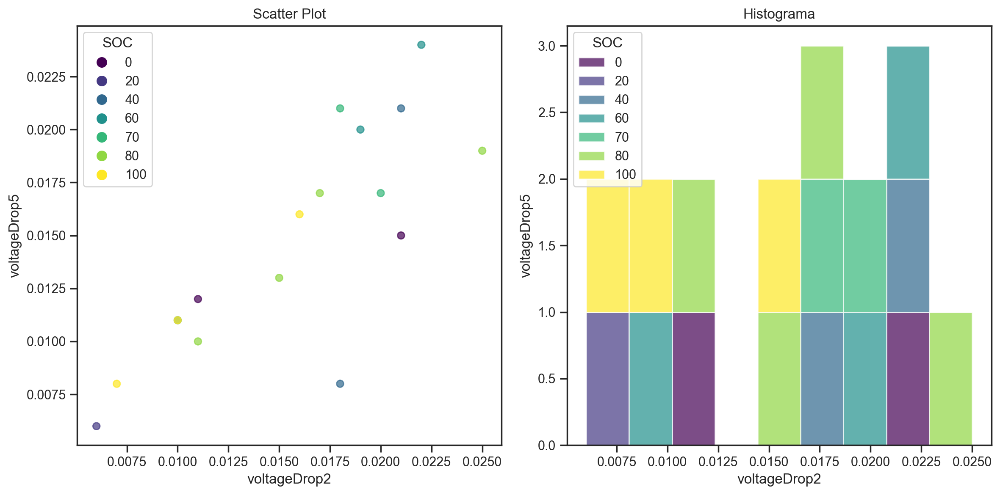

In [43]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'LFP'
x = df_data[(df_data.chemistry==quim)].voltageDrop2
y = df_data[(df_data.chemistry==quim)].voltageDrop5
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


### NMC 

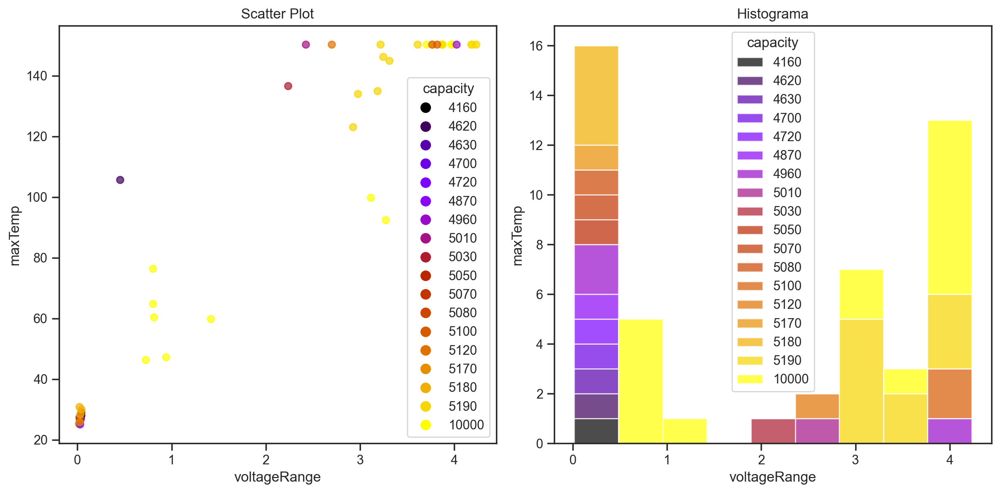

In [44]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].maxTemp
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


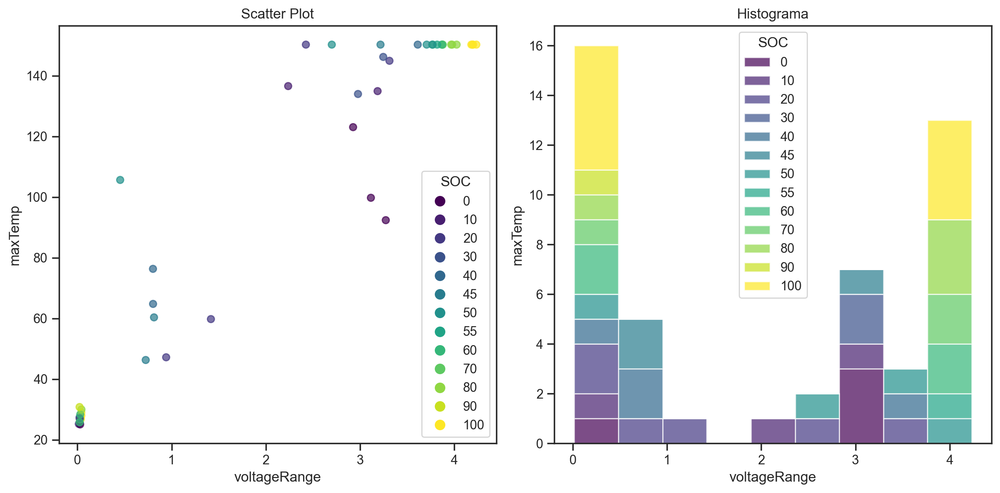

In [45]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].maxTemp
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


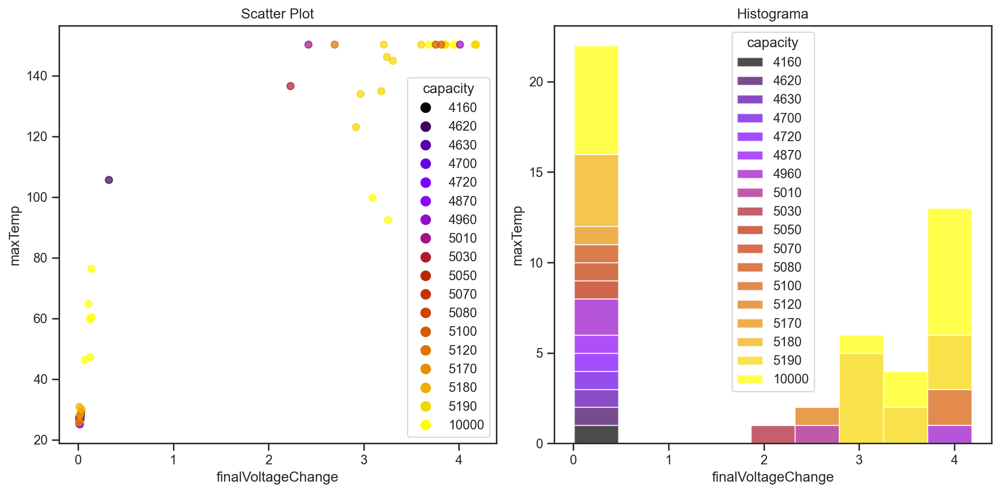

In [46]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].finalVoltageChange
y = df_data[(df_data.chemistry==quim)].maxTemp
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


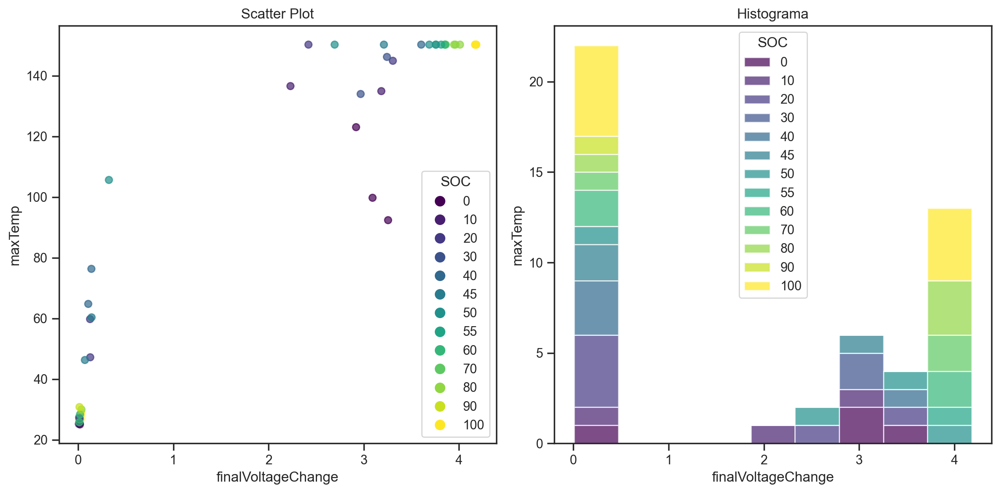

In [47]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].finalVoltageChange
y = df_data[(df_data.chemistry==quim)].maxTemp
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


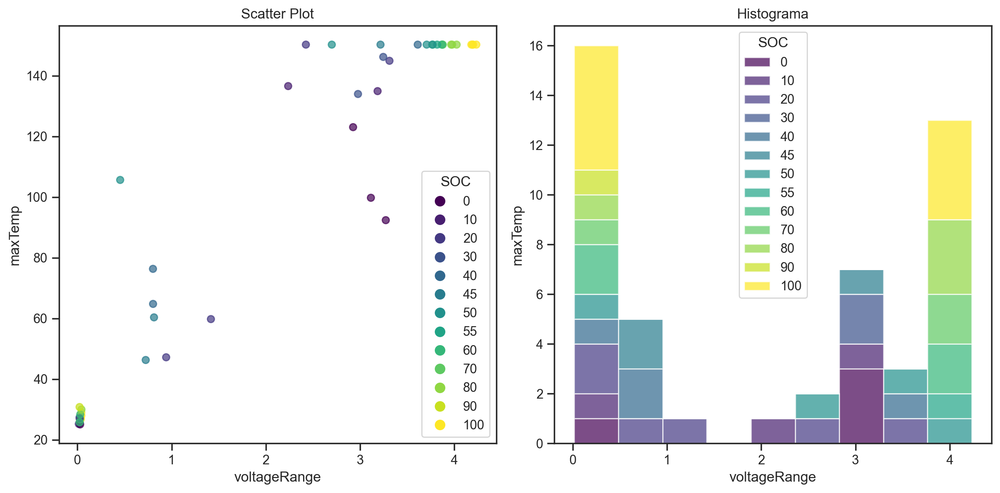

In [48]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].maxTemp
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


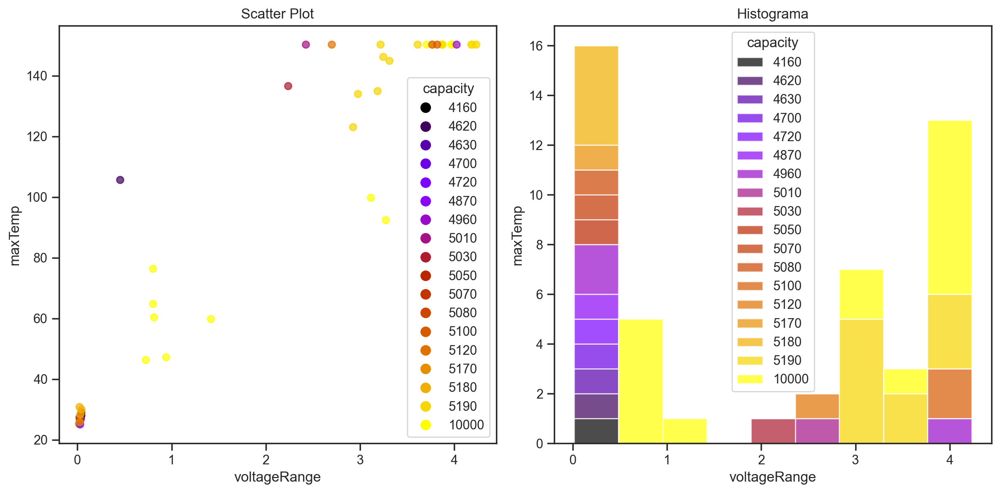

In [49]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].maxTemp
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


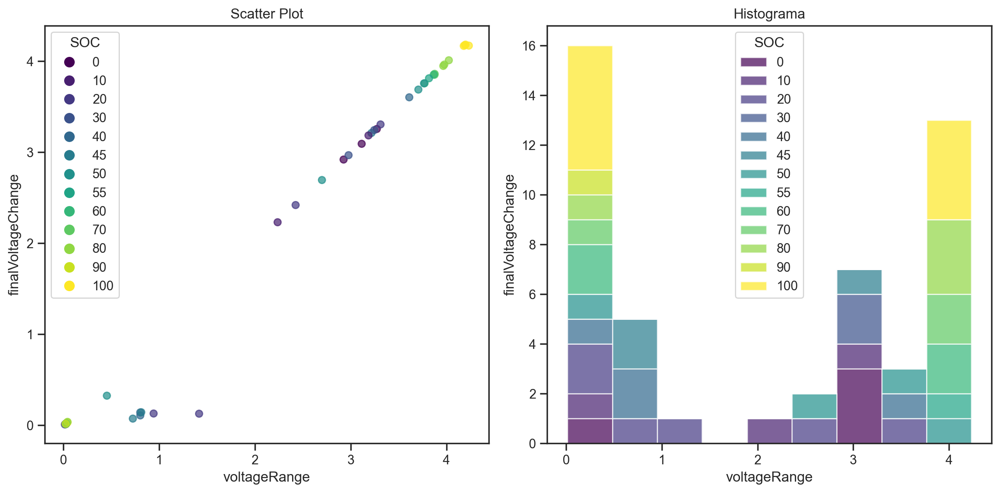

In [50]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


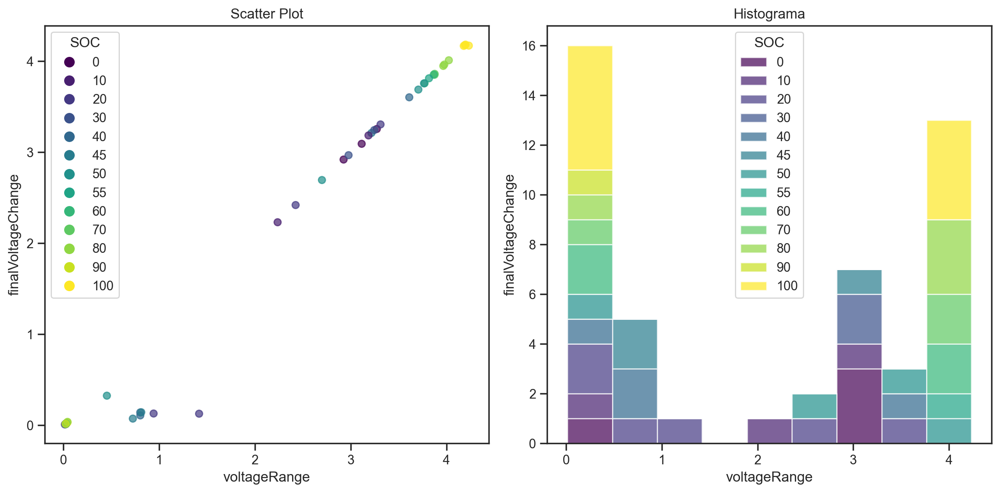

In [51]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


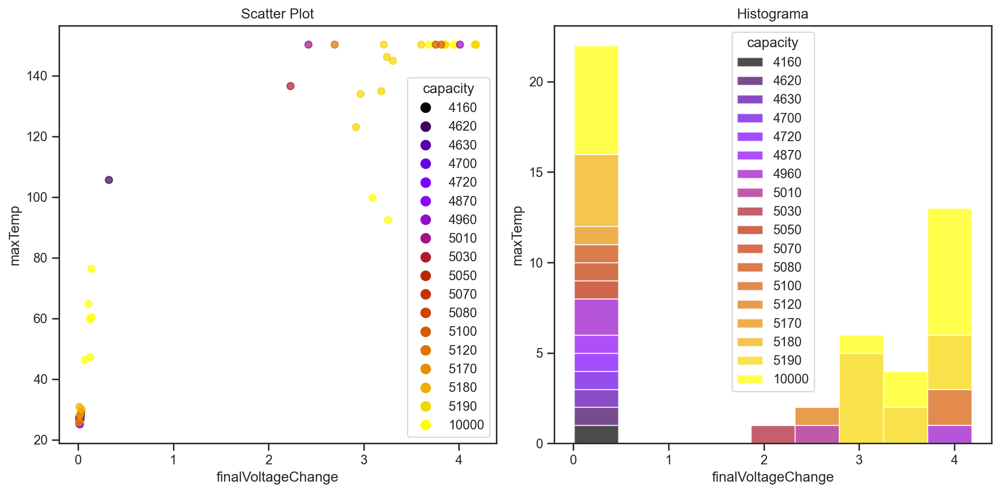

In [52]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].finalVoltageChange
y = df_data[(df_data.chemistry==quim)].maxTemp
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


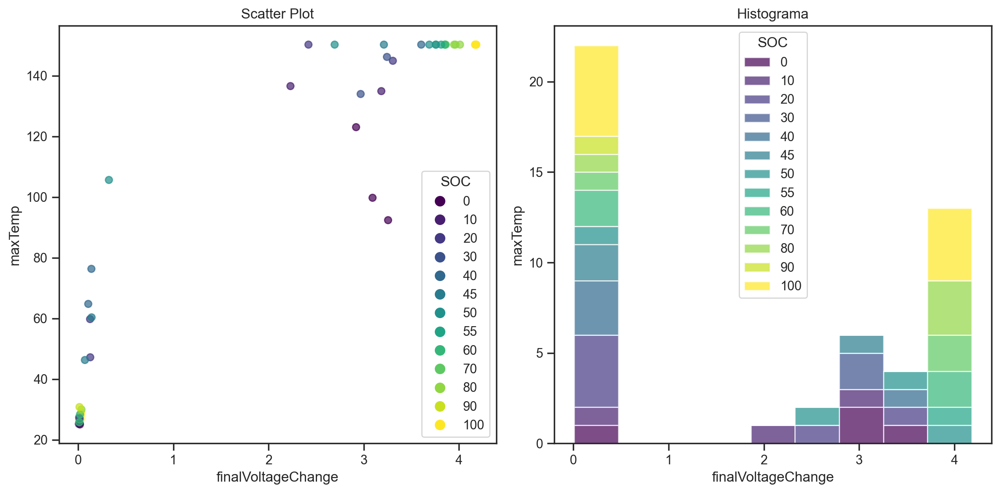

In [53]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].finalVoltageChange
y = df_data[(df_data.chemistry==quim)].maxTemp
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


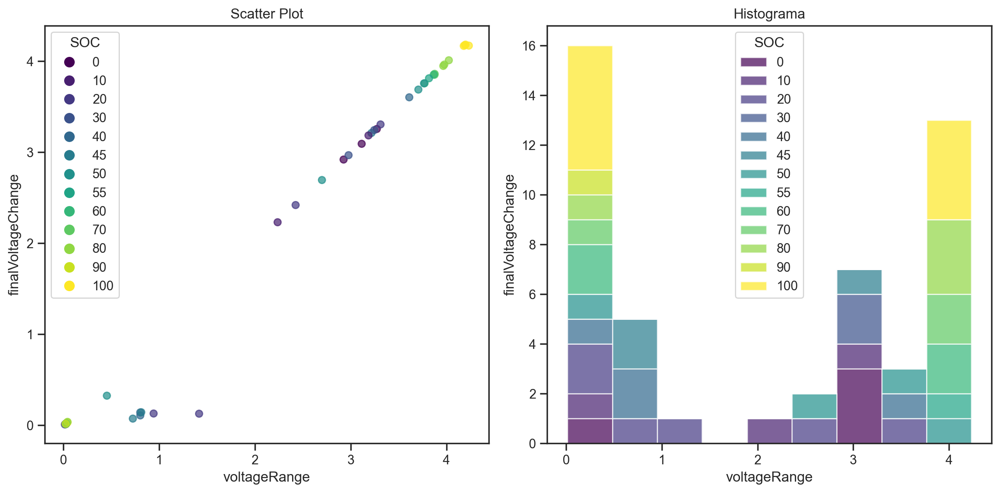

In [54]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].SOC

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


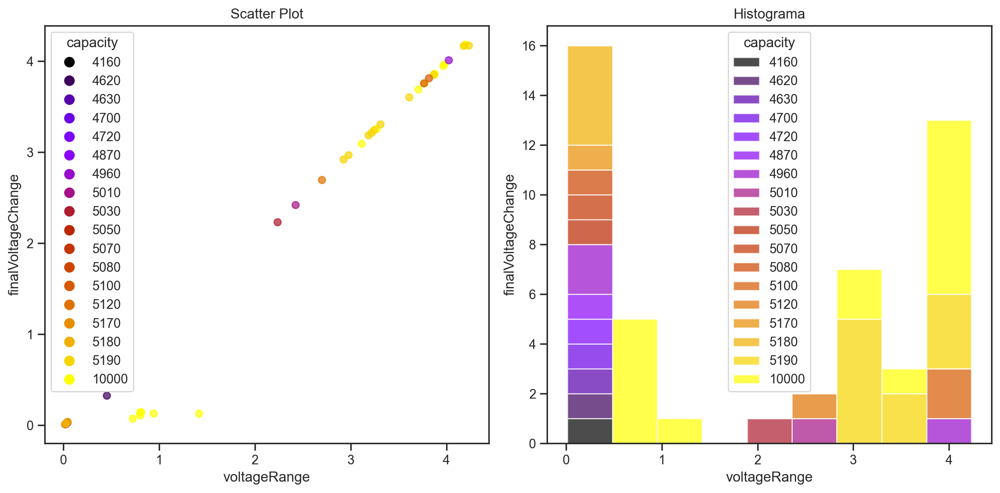

In [55]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


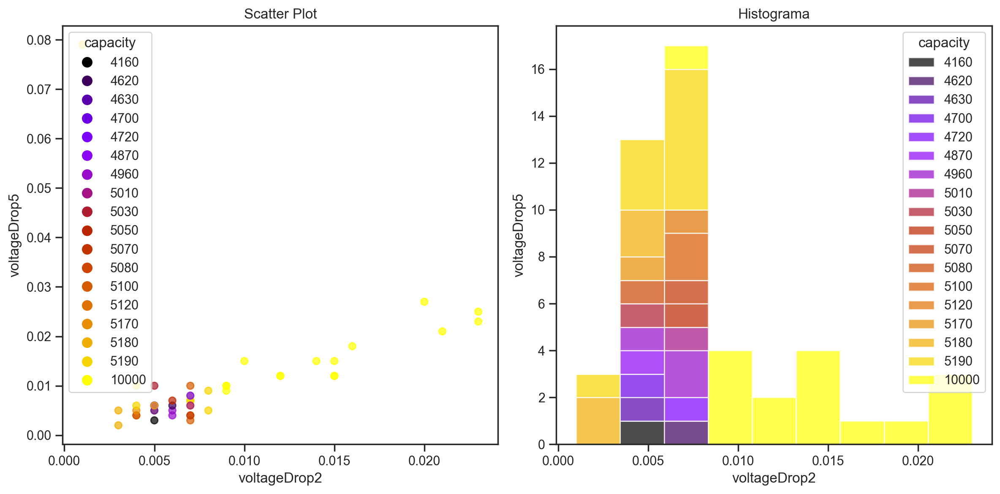

In [56]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].voltageDrop2
y = df_data[(df_data.chemistry==quim)].voltageDrop5
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()


### OTROS

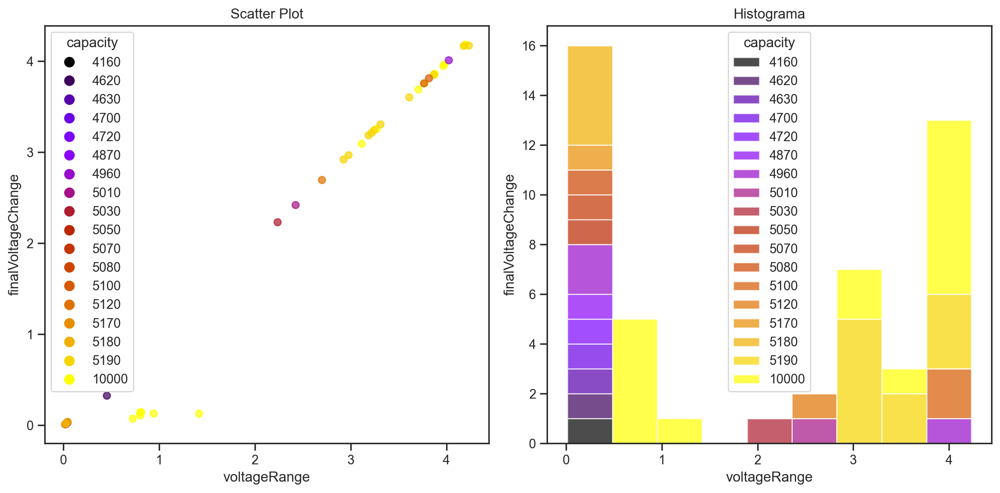

In [57]:
import matplotlib.pyplot as plt
import numpy as np
import os

# Supongamos que df_data ya está definido y contiene las columnas 'capacity', 'OHS' y 'col'
quim = 'NMC'
x = df_data[(df_data.chemistry==quim)].voltageRange
y = df_data[(df_data.chemistry==quim)].finalVoltageChange
col = df_data[(df_data.chemistry==quim)].capacity

# Definir los niveles únicos de col y una paleta de colores fija
col_levels = np.unique(col)
if col.name=='capacity':
    colors = plt.cm.gnuplot(np.linspace(0, 1, len(col_levels)))
elif col.name == 'SOC':
    colors = plt.cm.viridis(np.linspace(0, 1, len(col_levels)))
    

# Crear un diccionario para asignar un color específico a cada nivel de col
color_dict = {level: color for level, color in zip(col_levels, colors)}

# Crear el scatter plot con colores sólidos según col
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
scatter_colors = [color_dict[val] for val in col]
scatter = plt.scatter(x, y, c=scatter_colors, alpha=0.7)
# Crear un proxy para la leyenda
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color_dict[level], markersize=10) for level in col_levels]
plt.legend(handles, col_levels, title=f'{col.name}')
plt.title('Scatter Plot')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')

# Crear histograma apilado para la variable X según col
plt.subplot(1, 2, 2)
# Definir los bins para el histograma
bins = np.linspace(min(x), max(x), 10)

# Crear un array vacío para almacenar los datos apilados
stacked_data = []

# Iterar sobre los niveles de col y crear los histogramas
for level in col_levels:
    level_data = x[col == level]
    stacked_data.append(level_data)

# Plotear el histograma apilado con colores sólidos
plt.hist(stacked_data, bins=bins, stacked=True, label=col_levels, color=[color_dict[level] for level in col_levels], alpha=0.7)
plt.title('Histograma')
plt.xlabel(f'{x.name}')
plt.ylabel(f'{y.name}')
plt.legend(title=f'{col.name}')

plt.tight_layout()

# Especificar la carpeta y el nombre del archivo
output_folder = f'corr-figs/{quim}'
output_filename = f'{quim}-{x.name}-{y.name}-{col.name}.png'
output_path = os.path.join(output_folder, output_filename)

# Crear la carpeta si no existe
os.makedirs(output_folder, exist_ok=True)

# Guardar la figura
plt.savefig(output_path)

plt.show()
